# IMPORT

In [1]:
%matplotlib inline
import PIL.Image
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
import time
import inspect
import sys
import pygame

#serve per fare la progress bar del download
from clint.textui import progress
#serve per effetturare richieste http
import requests

# DOWNLOAD MODELLO VGG-16

In [2]:
if not os.path.exists("modello"):
    os.makedirs("modello")

percorso = "modello/vgg16.tfmodel"

if os.path.isfile(percorso):
    print("Modello già scaricato.")

else:
    url_modello = "https://s3.amazonaws.com/cadl/models/vgg16.tfmodel"

    richiesta = requests.get(url_modello, stream=True)
    with open(percorso, "wb") as file:
        lunghezza_totale = int(richiesta.headers.get('content-length'))
        for chunk in progress.mill(richiesta.iter_content(chunk_size=1024), expected_size=(lunghezza_totale/1024) + 1):
            if chunk:
                file.write(chunk)
                file.flush()
    print("Modello scaricato con successo.")

 / 540469/540469


Modello scaricato con successo.


# CLASSE VGG-16

In [3]:
class VGG16:
    
    nome_tensore_immagine_input = "images:0"
    
    #Strati convoluzionali da utilizzare ai fini dello Style Transfer
    nomi_strati = ['conv1_1/conv1_1', 'conv1_2/conv1_2',
                   'conv2_1/conv2_1', 'conv2_2/conv2_2',
                   'conv3_1/conv3_1', 'conv3_2/conv3_2', 'conv3_3/conv3_3',
                   'conv4_1/conv4_1', 'conv4_2/conv4_2', 'conv4_3/conv4_3',
                   'conv5_1/conv5_1', 'conv5_2/conv5_2', 'conv5_3/conv5_3']
    
    #costruttore
    def __init__(self):
        
        self.graph = tf.Graph()
        
        with self.graph.as_default():
            
            #apre il file precedentemente scaricato
            with tf.gfile.FastGFile(percorso, 'rb') as file:
                
                #copia di un grafo di tensorflow, inizialmente vuoto
                graph_def = tf.GraphDef()
                
                #viene aggiornata con il grafo del modello VGG16
                graph_def.ParseFromString(file.read())
                
                #infine viene importato sul grafo di default
                tf.import_graph_def(graph_def, name='')
                
            #ottiene un riferimento al tensore per dare in input le immagini al grafo
            self.input = self.graph.get_tensor_by_name(self.nome_tensore_immagine_input)
            
            #ottiene riferimenti ai tensori per gli strati convoluzionali presi in considerazione
            self.tensori_strati = [self.graph.get_tensor_by_name(nome + ":0") for nome in self.nomi_strati]
            
    def get_tensori_strati(self, id_strati):
        
        return [self.tensori_strati[indice] for indice in id_strati]
    
    def crea_feed_dict(self, immagine):
        #feed_dict contenente l'immagine da passare al grafo
        
        #VGG16 è stata progettata per prendere più immagini per input, è necessario
        #quindi aggiungere una dimensione alla terna che abbiamo inizialmente
        immagine = np.expand_dims(immagine, axis=0)
        
        feed_dict = {self.nome_tensore_immagine_input: immagine}
        
        return feed_dict

# MANIPOLAZIONE IMMAGINI

In [4]:
def carica_immagine(nomefile, dimensione_massima=None):
    immagine = PIL.Image.open(nomefile)
    
    if dimensione_massima is not None:
        #calcolo del fattore per il rescaling dell'immagine volto a mantenere le 
        #proporzioni tra altezza e larghezza
        fattore_rescaling = dimensione_massima / np.max(immagine.size)

        dimensione = np.array(immagine.size) * fattore_rescaling
        dimensione = dimensione.astype(int)

        immagine = immagine.resize(dimensione, PIL.Image.LANCZOS)
    
    return np.float32(immagine)
    
    

In [5]:
def salva_immagine(immagine, nomefile):
    
    immagine = np.clip(immagine, 0.0, 255.0)
    
    immagine = immagine.astype(np.uint8)
    
    with open(nomefile, "wb") as file:
        PIL.Image.fromarray(immagine).save(file, 'jpeg')

In [6]:
def mostra_immagine(immagine):
    
    immagine = np.clip(immagine, 0.0, 255.0)
    
    immagine = immagine.astype(np.uint8)
    
    display(PIL.Image.fromarray(immagine))

# FUNZIONI PER IL CALCOLO DELLA PERDITA

In [7]:
def MSE(x, y):
    return tf.reduce_mean(tf.square(x-y))

## CALCOLO PERDITA CONTENUTO

In [8]:
def calcola_perdita_contenuto(sessione, modello, immagine_contenuto, id_strati):
    
    feed_dict = modello.crea_feed_dict(immagine=immagine_contenuto)
    
    strati = modello.get_tensori_strati(id_strati)
    
    valori = sessione.run(strati, feed_dict=feed_dict)
    
    with modello.graph.as_default():
        
        perdite_strati = []
        
        for valore, strato in zip(valori, strati):
            
            costante_valore = tf.constant(valore)
            
            perdita = MSE(strato, costante_valore)
            
            perdite_strati.append(perdita)
            
        perdita_totale = tf.reduce_mean(perdite_strati)
        
    return perdita_totale

## MATRICE GRAM

In [9]:
def matrice_gram(tensore):
    
    shape = tensore.get_shape()
    
    numero_canali = int(shape[3])
    
    matrice = tf.reshape(tensore, shape=[-1, numero_canali])
    
    gramiana = tf.matmul(tf.transpose(matrice), matrice)
    
    return gramiana

## CALCOLO PERDITA STILE

In [10]:
def calcola_perdita_stile(sessione, modello, immagine_stile, id_strati):
    
    feed_dict = modello.crea_feed_dict(immagine = immagine_stile)
    
    strati = modello.get_tensori_strati(id_strati)
    
    with modello.graph.as_default():
        
        strati_gram = [matrice_gram(strato) for strato in strati]
        
        valori = sessione.run(strati_gram, feed_dict=feed_dict)
        
        perdite_strati = []
        
        for valore, strato_gram in zip(valori, strati_gram):
            
            costante_valore = tf.constant(valore)
            
            perdita = MSE(strato_gram, costante_valore)
            
            perdite_strati.append(perdita)
            
        perdita_totale = tf.reduce_mean(perdite_strati)
        
    return perdita_totale

# STYLE TRANSFER

In [11]:
def style_transfer(immagine_contenuto, immagine_stile, id_strati_contenuto, 
                   id_strati_stile, peso_contenuto=1.5, peso_stile=10.0,
                   minuti=60, passo=10.0):
    
    ora = time.time()
    
    timeout = time.time() + 60*minuti
    
    modello = VGG16()
    
    sessione = tf.InteractiveSession(graph=modello.graph)
    
    print("Ora inizio: "+str(ora))
    
    print("INZIO ALGORITMO STYLE TRANSFER")
    time.sleep(1)
    
    print()
    print("IMMAGINE CONTENUTO:")
    mostra_immagine(immagine_contenuto)
    time.sleep(1)
    
    print()
    print("IMMAGINE STILE:")
    mostra_immagine(immagine_stile)
    time.sleep(1)
    
    perdita_contenuto = calcola_perdita_contenuto(sessione=sessione,
                                                  modello=modello,
                                                  immagine_contenuto=immagine_contenuto,
                                                  id_strati=id_strati_contenuto)
    
    perdita_stile = calcola_perdita_stile(sessione=sessione, modello=modello,
                                         immagine_stile=immagine_stile,
                                         id_strati=id_strati_stile)
    
    #inizializzate a valori prossimi allo 0
    agg_contenuto = tf.Variable(1e-10, name='agg_contenuto')
    agg_stile = tf.Variable(1e-10, name='agg_stile')
    
    #inizializza variabili
    sessione.run([agg_contenuto.initializer,
                 agg_stile.initializer])
    
    #la somma ha lo scopo di evitare divisioni per zero
    aggiorna_agg_contenuto = agg_contenuto.assign(1.0 / (perdita_contenuto + 1e-10))
    aggiorna_agg_stile = agg_stile.assign(1.0 / (perdita_stile + 1e-10))

    perdita_complessiva = peso_contenuto * agg_contenuto * perdita_contenuto + \
                          peso_stile * agg_stile * perdita_stile
    
    gradiente = tf.gradients(perdita_complessiva, modello.input)
    
    run_lista = [gradiente, aggiorna_agg_contenuto, aggiorna_agg_stile]
    
    #randomizzazione
    immagine_risultato = np.random.rand(*immagine_contenuto.shape) + 128
    
    #VERSIONE BASATA SU CONVERGENZA
    #total_loss_log = [[sys.maxsize, sys.maxsize]]
    
    i = 0
    
    while True:
        
        inizio = time.time()
        
        feed_dict = modello.crea_feed_dict(immagine=immagine_risultato)
        
        grad, valore_agg_contenuto, valore_agg_stile = sessione.run(run_lista, feed_dict=feed_dict)
        
        #Rimuove entry monodimensionali dalla shape di un array.
        grad = np.squeeze(grad)
        
        passo_scalato = passo/ (np.std(grad) + 1e-8)
        
        immagine_risultato -= grad*passo_scalato
        
        immagine_risultato = np.clip(immagine_risultato, 0.0, 255.0)
        
        fine = time.time()
        
        trascorso = fine - inizio
        
        print()
        print("Iterazione "+str(i)+" completata in "+str(trascorso)+" secondi")
        print('Perdita Stile: {} Perdita Contenuto: {}'.format(valore_agg_stile, valore_agg_contenuto))

        if (i % 10 == 0):
            
            print()
            print("Risultato dopo "+str(i)+" iterazioni: ")
            mostra_immagine(immagine_risultato)
            
        #total_loss_log.append([valore_agg_stile, valore_agg_contenuto])
        
        i += 1
        
        #print((total_loss_log[-1][0]-total_loss_log[-2][0]) + abs(total_loss_log[-1][1]-total_loss_log[-2][1])*pow(10,11))
        #if (abs(total_loss_log[-1][0]-total_loss_log[-2][0]) + abs(total_loss_log[-1][1]-total_loss_log[-2][1]))*pow(10,11) < precisione and i > 2:
            
        #    break
        
        print("Tempo totale trascorso: "+str(fine-ora)+" secondi")
        
        if time.time() > timeout:
            
            break
    
    sessione.close()
    
    return immagine_risultato

In [12]:
file_immagine_contenuto = "immagini/erika.jpg"
immagine_contenuto = carica_immagine(file_immagine_contenuto, dimensione_massima=None)

In [13]:
file_immagine_stile = "immagini/notte.jpg"
immagine_stile = carica_immagine(file_immagine_stile, dimensione_massima=512)

In [14]:
id_strato_contenuto = [4]

In [15]:
id_strati_stile = list(range(13))

Ora inizio: 1516362783.9074745
INZIO ALGORITMO STYLE TRANSFER

IMMAGINE CONTENUTO:


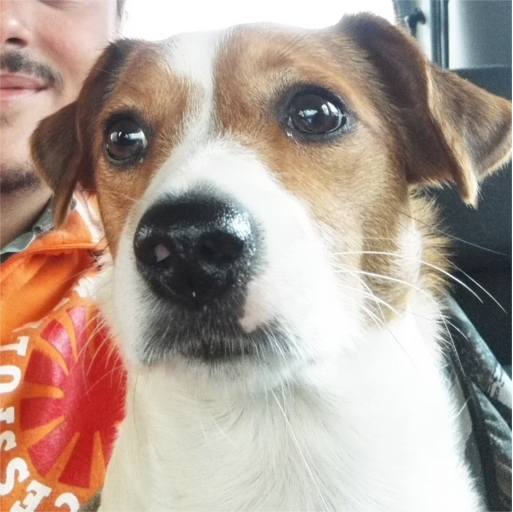


IMMAGINE STILE:


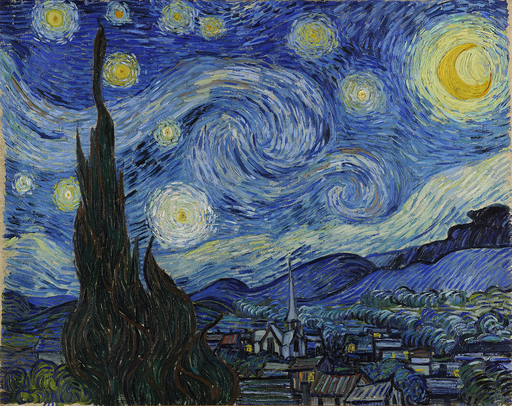


Iterazione 0 completata in 7.088039398193359 secondi
Perdita Stile: 3.3684562875581365e-29 Perdita Contenuto: 7.865830209397018e-11

Risultato dopo 0 iterazioni: 


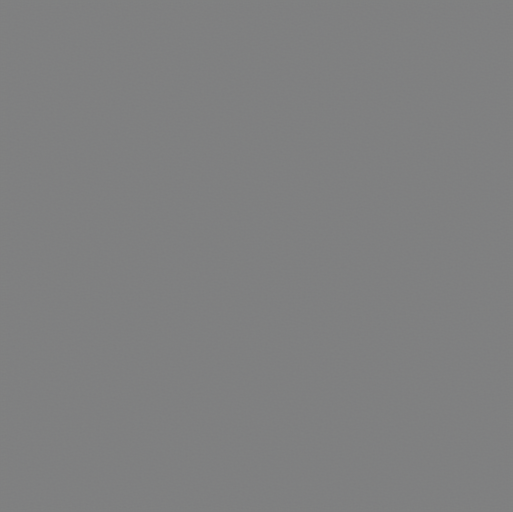

Tempo totale trascorso: 21.220952033996582 secondi

Iterazione 1 completata in 6.500671625137329 secondi
Perdita Stile: 3.4601278445719846e-29 Perdita Contenuto: 7.890759573525585e-11
Tempo totale trascorso: 27.85294222831726 secondi

Iterazione 2 completata in 6.446166515350342 secondi
Perdita Stile: 3.5600240252280277e-29 Perdita Contenuto: 8.055648509364133e-11
Tempo totale trascorso: 34.29946947097778 secondi

Iterazione 3 completata in 6.504019021987915 secondi
Perdita Stile: 3.6675655459101804e-29 Perdita Contenuto: 8.262868167463466e-11
Tempo totale trascorso: 40.80366611480713 secondi

Iterazione 4 completata in 6.466896295547485 secondi
Perdita Stile: 3.7835805564945294e-29 Perdita Contenuto: 8.489701303071584e-11
Tempo totale trascorso: 47.27074408531189 secondi

Iterazione 5 completata in 6.477958917617798 secondi
Perdita Stile: 3.907093152167067e-29 Perdita Contenuto: 8.722120942161737e-11
Tempo totale trascorso: 53.74886345863342 secondi

Iterazione 6 completata in 6.54669

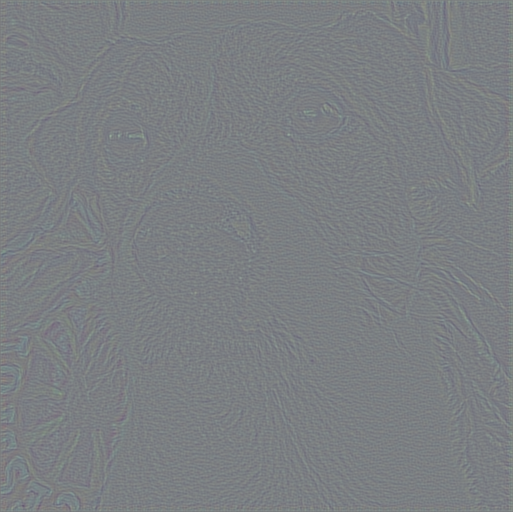

Tempo totale trascorso: 86.27532768249512 secondi

Iterazione 11 completata in 6.513081073760986 secondi
Perdita Stile: 4.8072135256425605e-29 Perdita Contenuto: 1.0028761848746015e-10
Tempo totale trascorso: 92.92365074157715 secondi

Iterazione 12 completata in 6.493680000305176 secondi
Perdita Stile: 4.988364991578855e-29 Perdita Contenuto: 1.0188919846720879e-10
Tempo totale trascorso: 99.41750407218933 secondi

Iterazione 13 completata in 6.52501654624939 secondi
Perdita Stile: 5.179917983847609e-29 Perdita Contenuto: 1.0327188409986476e-10
Tempo totale trascorso: 105.94267463684082 secondi

Iterazione 14 completata in 6.497335910797119 secondi
Perdita Stile: 5.382675073567837e-29 Perdita Contenuto: 1.0442822301337529e-10
Tempo totale trascorso: 112.44019985198975 secondi

Iterazione 15 completata in 6.493117332458496 secondi
Perdita Stile: 5.597478253237098e-29 Perdita Contenuto: 1.0536262140536934e-10
Tempo totale trascorso: 118.93364715576172 secondi

Iterazione 16 completata i

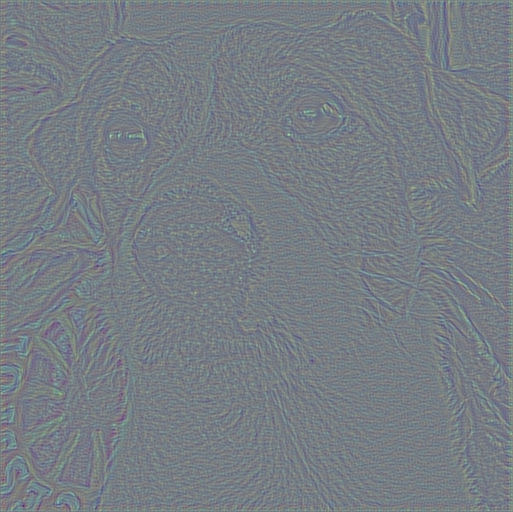

Tempo totale trascorso: 151.4445719718933 secondi

Iterazione 21 completata in 6.526805877685547 secondi
Perdita Stile: 7.191650514669727e-29 Perdita Contenuto: 1.0658274957053848e-10
Tempo totale trascorso: 158.0543794631958 secondi

Iterazione 22 completata in 6.503148317337036 secondi
Perdita Stile: 7.517055638073394e-29 Perdita Contenuto: 1.0611839879048901e-10
Tempo totale trascorso: 164.5577027797699 secondi

Iterazione 23 completata in 6.465054035186768 secondi
Perdita Stile: 7.86152385680785e-29 Perdita Contenuto: 1.0550186418933905e-10
Tempo totale trascorso: 171.02291131019592 secondi

Iterazione 24 completata in 6.559993743896484 secondi
Perdita Stile: 8.225451792071015e-29 Perdita Contenuto: 1.0475292855360863e-10
Tempo totale trascorso: 177.5830738544464 secondi

Iterazione 25 completata in 6.551215887069702 secondi
Perdita Stile: 8.609031435004222e-29 Perdita Contenuto: 1.0389716864622756e-10
Tempo totale trascorso: 184.13443279266357 secondi

Iterazione 26 completata in 

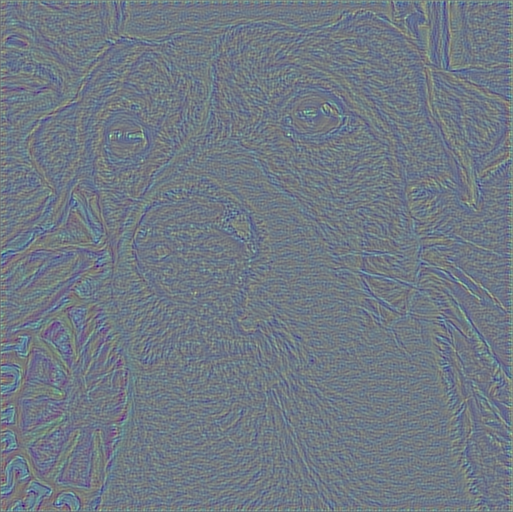

Tempo totale trascorso: 216.56169652938843 secondi

Iterazione 31 completata in 6.557745695114136 secondi
Perdita Stile: 1.1364089266777853e-28 Perdita Contenuto: 9.81608683225943e-11
Tempo totale trascorso: 223.18522357940674 secondi

Iterazione 32 completata in 6.495977401733398 secondi
Perdita Stile: 1.1925119881815146e-28 Perdita Contenuto: 9.735707379165959e-11
Tempo totale trascorso: 229.68135476112366 secondi

Iterazione 33 completata in 6.474611520767212 secondi
Perdita Stile: 1.25351184693947e-28 Perdita Contenuto: 9.665698103011877e-11
Tempo totale trascorso: 236.1561164855957 secondi

Iterazione 34 completata in 6.47201943397522 secondi
Perdita Stile: 1.3210187007557808e-28 Perdita Contenuto: 9.607522416521519e-11
Tempo totale trascorso: 242.62830567359924 secondi

Iterazione 35 completata in 6.568606376647949 secondi
Perdita Stile: 1.3972054800902017e-28 Perdita Contenuto: 9.56303786159296e-11
Tempo totale trascorso: 249.19733023643494 secondi

Iterazione 36 completata in 6

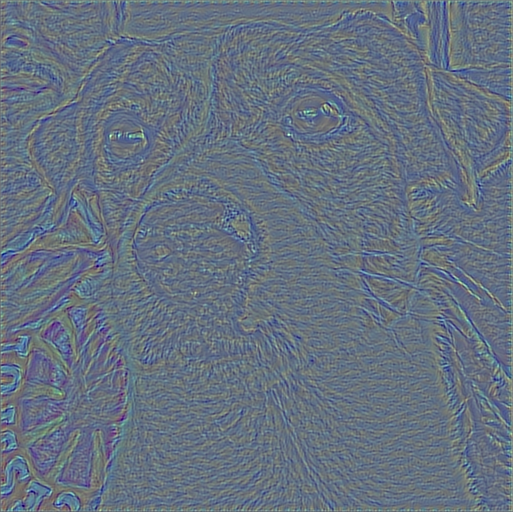

Tempo totale trascorso: 281.740478515625 secondi

Iterazione 41 completata in 6.508338212966919 secondi
Perdita Stile: 2.2398363030579392e-28 Perdita Contenuto: 9.544104395686759e-11
Tempo totale trascorso: 288.31188440322876 secondi

Iterazione 42 completata in 6.434479713439941 secondi
Perdita Stile: 2.483825626957553e-28 Perdita Contenuto: 9.555806840255698e-11
Tempo totale trascorso: 294.7465307712555 secondi

Iterazione 43 completata in 6.608950853347778 secondi
Perdita Stile: 2.769371944973425e-28 Perdita Contenuto: 9.564792707861258e-11
Tempo totale trascorso: 301.3556749820709 secondi

Iterazione 44 completata in 6.503842115402222 secondi
Perdita Stile: 3.1018500460978545e-28 Perdita Contenuto: 9.570293169058885e-11
Tempo totale trascorso: 307.8596935272217 secondi

Iterazione 45 completata in 6.499268293380737 secondi
Perdita Stile: 3.4877765550389185e-28 Perdita Contenuto: 9.57293064263176e-11
Tempo totale trascorso: 314.3591368198395 secondi

Iterazione 46 completata in 6.51

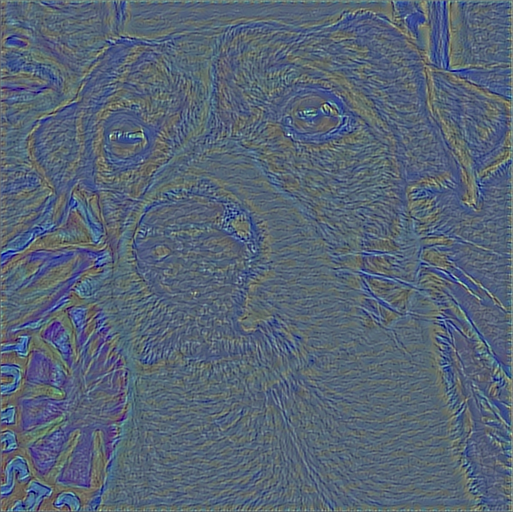

Tempo totale trascorso: 346.89232563972473 secondi

Iterazione 51 completata in 6.517911195755005 secondi
Perdita Stile: 7.372839235313383e-28 Perdita Contenuto: 9.551472113233928e-11
Tempo totale trascorso: 353.4746165275574 secondi

Iterazione 52 completata in 6.479938268661499 secondi
Perdita Stile: 8.37091776225307e-28 Perdita Contenuto: 9.542101137016701e-11
Tempo totale trascorso: 359.95475912094116 secondi

Iterazione 53 completata in 6.476837396621704 secondi
Perdita Stile: 9.501469454487487e-28 Perdita Contenuto: 9.538774631279168e-11
Tempo totale trascorso: 366.4317955970764 secondi

Iterazione 54 completata in 6.496574878692627 secondi
Perdita Stile: 1.0763226087148257e-27 Perdita Contenuto: 9.520729343792667e-11
Tempo totale trascorso: 372.9285247325897 secondi

Iterazione 55 completata in 6.494867324829102 secondi
Perdita Stile: 1.2164940048867648e-27 Perdita Contenuto: 9.533019512675267e-11
Tempo totale trascorso: 379.4235599040985 secondi

Iterazione 56 completata in 6.5

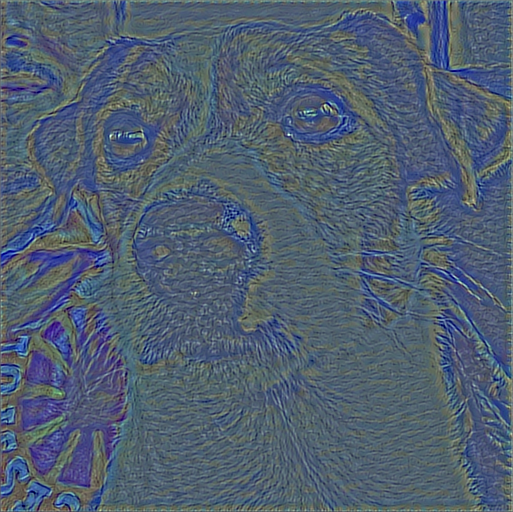

Tempo totale trascorso: 412.0077910423279 secondi

Iterazione 61 completata in 6.610872268676758 secondi
Perdita Stile: 1.919142389484232e-27 Perdita Contenuto: 9.532110517573855e-11
Tempo totale trascorso: 418.67977643013 secondi

Iterazione 62 completata in 6.56676173210144 secondi
Perdita Stile: 2.046678048180538e-27 Perdita Contenuto: 9.425666497309138e-11
Tempo totale trascorso: 425.2467269897461 secondi

Iterazione 63 completata in 6.515207767486572 secondi
Perdita Stile: 2.1695019192679007e-27 Perdita Contenuto: 9.523438981862142e-11
Tempo totale trascorso: 431.7621216773987 secondi

Iterazione 64 completata in 6.522886276245117 secondi
Perdita Stile: 2.3091301068990253e-27 Perdita Contenuto: 9.413424206794474e-11
Tempo totale trascorso: 438.28517603874207 secondi

Iterazione 65 completata in 6.490693807601929 secondi
Perdita Stile: 2.4378817977622175e-27 Perdita Contenuto: 9.514277560240814e-11
Tempo totale trascorso: 444.77606439590454 secondi

Iterazione 66 completata in 6.51

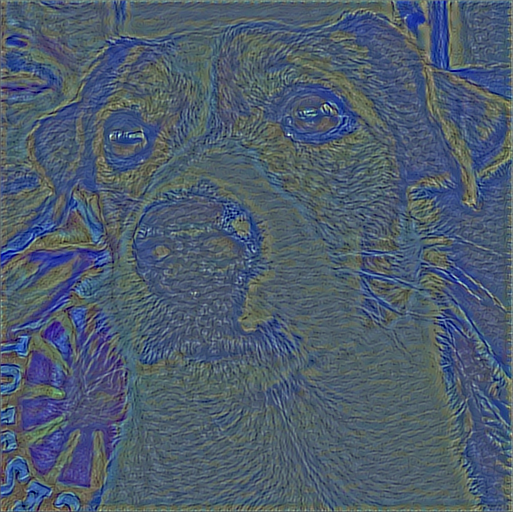

Tempo totale trascorso: 477.2586395740509 secondi

Iterazione 71 completata in 6.526819705963135 secondi
Perdita Stile: 3.352700832462088e-27 Perdita Contenuto: 9.485347229887253e-11
Tempo totale trascorso: 483.84657073020935 secondi

Iterazione 72 completata in 6.457826614379883 secondi
Perdita Stile: 3.5503913782776155e-27 Perdita Contenuto: 9.363378822291324e-11
Tempo totale trascorso: 490.30457401275635 secondi

Iterazione 73 completata in 6.492250442504883 secondi
Perdita Stile: 3.6946843608270405e-27 Perdita Contenuto: 9.475132484171311e-11
Tempo totale trascorso: 496.7969882488251 secondi

Iterazione 74 completata in 6.492883920669556 secondi
Perdita Stile: 3.909929372899669e-27 Perdita Contenuto: 9.350627216964114e-11
Tempo totale trascorso: 503.2902021408081 secondi

Iterazione 75 completata in 6.489253282546997 secondi
Perdita Stile: 4.055643306562063e-27 Perdita Contenuto: 9.464997535735264e-11
Tempo totale trascorso: 509.77962136268616 secondi

Iterazione 76 completata in 6

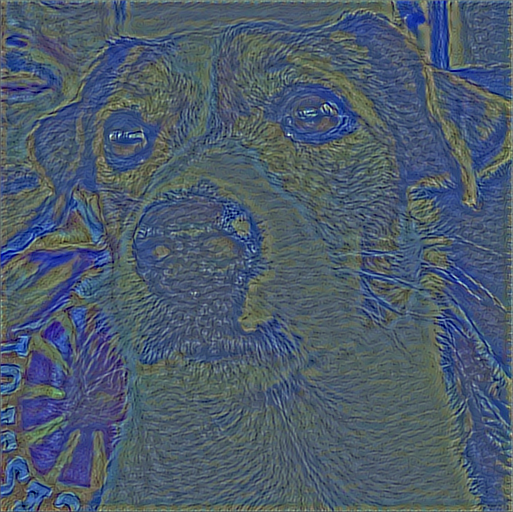

Tempo totale trascorso: 542.422191619873 secondi

Iterazione 81 completata in 6.548626899719238 secondi
Perdita Stile: 5.249182152441676e-27 Perdita Contenuto: 9.435218578657256e-11
Tempo totale trascorso: 549.0300426483154 secondi

Iterazione 82 completata in 6.5107011795043945 secondi
Perdita Stile: 5.5501722619403466e-27 Perdita Contenuto: 9.301003717210321e-11
Tempo totale trascorso: 555.5408978462219 secondi

Iterazione 83 completata in 6.503689527511597 secondi
Perdita Stile: 5.681448269181647e-27 Perdita Contenuto: 9.425414615460426e-11
Tempo totale trascorso: 562.0447392463684 secondi

Iterazione 84 completata in 6.514784336090088 secondi
Perdita Stile: 6.008111410024988e-27 Perdita Contenuto: 9.288988328526315e-11
Tempo totale trascorso: 568.5598800182343 secondi

Iterazione 85 completata in 6.47297215461731 secondi
Perdita Stile: 6.128593735485965e-27 Perdita Contenuto: 9.415752899588625e-11
Tempo totale trascorso: 575.0330197811127 secondi

Iterazione 86 completata in 6.4912

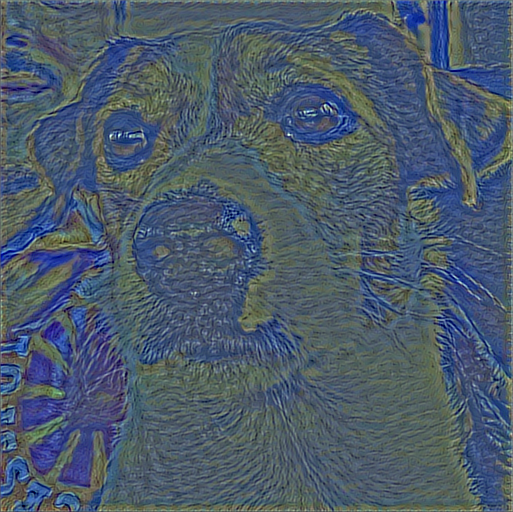

Tempo totale trascorso: 607.554981470108 secondi

Iterazione 91 completata in 6.5532145500183105 secondi
Perdita Stile: 7.542618048816884e-27 Perdita Contenuto: 9.388098631823993e-11
Tempo totale trascorso: 614.1698176860809 secondi

Iterazione 92 completata in 6.47837233543396 secondi
Perdita Stile: 7.992096201469844e-27 Perdita Contenuto: 9.242854398516798e-11
Tempo totale trascorso: 620.6483595371246 secondi

Iterazione 93 completata in 6.458305835723877 secondi
Perdita Stile: 8.031836610314308e-27 Perdita Contenuto: 9.379629017924884e-11
Tempo totale trascorso: 627.106841802597 secondi

Iterazione 94 completata in 6.481034278869629 secondi
Perdita Stile: 8.517829624340872e-27 Perdita Contenuto: 9.232029724026702e-11
Tempo totale trascorso: 633.5880262851715 secondi

Iterazione 95 completata in 6.473140001296997 secondi
Perdita Stile: 8.527069465842064e-27 Perdita Contenuto: 9.371188547380171e-11
Tempo totale trascorso: 640.0613310337067 secondi

Iterazione 96 completata in 6.498337

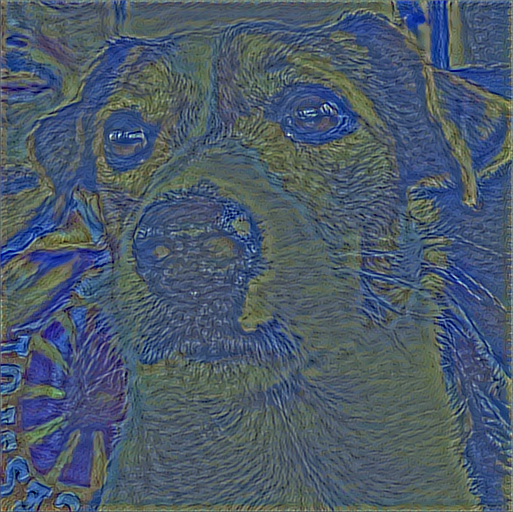

Tempo totale trascorso: 672.7283952236176 secondi

Iterazione 101 completata in 6.535510540008545 secondi
Perdita Stile: 1.0028140034869453e-26 Perdita Contenuto: 9.347381896285256e-11
Tempo totale trascorso: 679.3218014240265 secondi

Iterazione 102 completata in 6.506741762161255 secondi
Perdita Stile: 1.0687803396445147e-26 Perdita Contenuto: 9.191380295758833e-11
Tempo totale trascorso: 685.8287403583527 secondi

Iterazione 103 completata in 6.477754592895508 secondi
Perdita Stile: 1.0528562886411344e-26 Perdita Contenuto: 9.339937157015754e-11
Tempo totale trascorso: 692.306672334671 secondi

Iterazione 104 completata in 6.468133926391602 secondi
Perdita Stile: 1.1239785703714218e-26 Perdita Contenuto: 9.181934379487444e-11
Tempo totale trascorso: 698.7749948501587 secondi

Iterazione 105 completata in 6.481595516204834 secondi
Perdita Stile: 1.1027746979813005e-26 Perdita Contenuto: 9.332600664491153e-11
Tempo totale trascorso: 705.256769657135 secondi

Iterazione 106 completata 

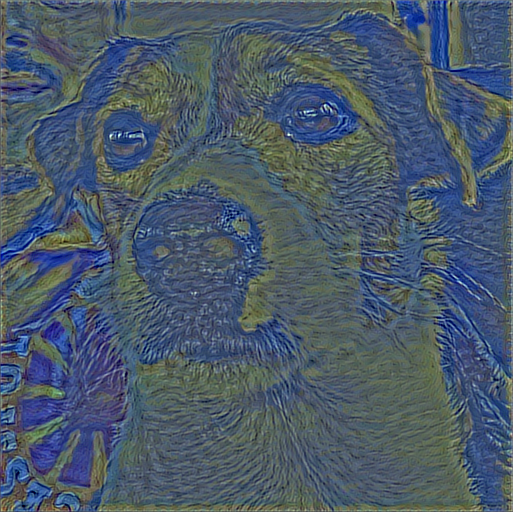

Tempo totale trascorso: 737.7992386817932 secondi

Iterazione 111 completata in 6.531771183013916 secondi
Perdita Stile: 1.2508449684120533e-26 Perdita Contenuto: 9.311851290050299e-11
Tempo totale trascorso: 744.3894019126892 secondi

Iterazione 112 completata in 6.494908809661865 secondi
Perdita Stile: 1.345595637220852e-26 Perdita Contenuto: 9.146873536369782e-11
Tempo totale trascorso: 750.884462594986 secondi

Iterazione 113 completata in 6.483879566192627 secondi
Perdita Stile: 1.2994560565059693e-26 Perdita Contenuto: 9.305149706317906e-11
Tempo totale trascorso: 757.368702173233 secondi

Iterazione 114 completata in 6.487348556518555 secondi
Perdita Stile: 1.4009031066942048e-26 Perdita Contenuto: 9.138702988797931e-11
Tempo totale trascorso: 763.8562185764313 secondi

Iterazione 115 completata in 6.490074872970581 secondi
Perdita Stile: 1.3475973717678504e-26 Perdita Contenuto: 9.298725678341668e-11
Tempo totale trascorso: 770.3464732170105 secondi

Iterazione 116 completata i

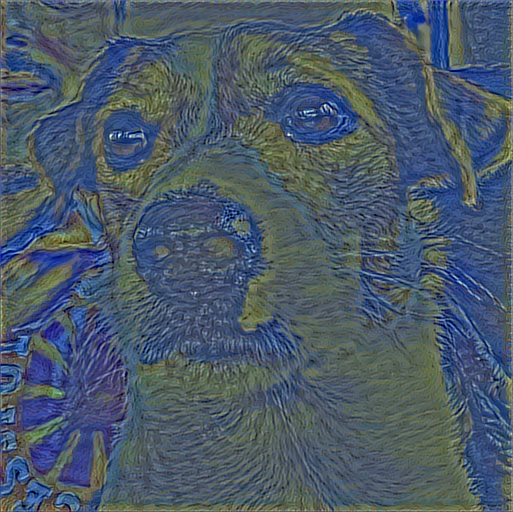

Tempo totale trascorso: 803.1300745010376 secondi

Iterazione 121 completata in 6.587553977966309 secondi
Perdita Stile: 1.4889430652047807e-26 Perdita Contenuto: 9.279995522026852e-11
Tempo totale trascorso: 809.778472661972 secondi

Iterazione 122 completata in 6.517398834228516 secondi
Perdita Stile: 1.6202765421956218e-26 Perdita Contenuto: 9.107883891523727e-11
Tempo totale trascorso: 816.2960484027863 secondi

Iterazione 123 completata in 6.529095888137817 secondi
Perdita Stile: 1.535118853402618e-26 Perdita Contenuto: 9.273982276569726e-11
Tempo totale trascorso: 822.8253080844879 secondi

Iterazione 124 completata in 6.5020856857299805 secondi
Perdita Stile: 1.6746965431506008e-26 Perdita Contenuto: 9.100561276786934e-11
Tempo totale trascorso: 829.3275668621063 secondi

Iterazione 125 completata in 6.515983819961548 secondi
Perdita Stile: 1.5808049931713942e-26 Perdita Contenuto: 9.268057155065179e-11
Tempo totale trascorso: 835.8437325954437 secondi

Iterazione 126 completata

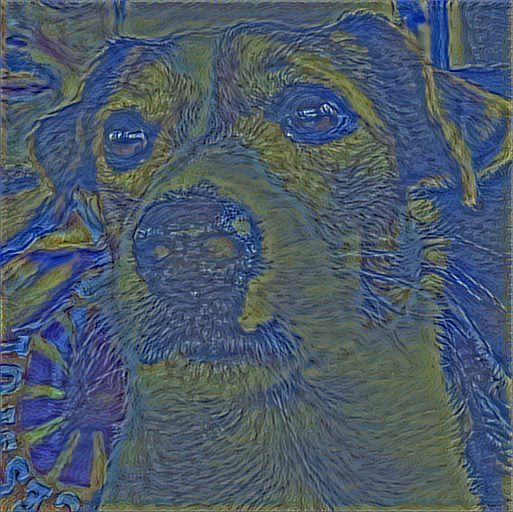

Tempo totale trascorso: 868.4590375423431 secondi

Iterazione 131 completata in 6.5203564167022705 secondi
Perdita Stile: 1.7149287574656635e-26 Perdita Contenuto: 9.251042293323408e-11
Tempo totale trascorso: 875.0384204387665 secondi

Iterazione 132 completata in 6.494009256362915 secondi
Perdita Stile: 1.890265881825864e-26 Perdita Contenuto: 9.072924356257062e-11
Tempo totale trascorso: 881.5326035022736 secondi

Iterazione 133 completata in 6.4687111377716064 secondi
Perdita Stile: 1.758640125706663e-26 Perdita Contenuto: 9.245470361518571e-11
Tempo totale trascorso: 888.0014774799347 secondi

Iterazione 134 completata in 6.502751588821411 secondi
Perdita Stile: 1.9436546628514205e-26 Perdita Contenuto: 9.066311590366638e-11
Tempo totale trascorso: 894.5043852329254 secondi

Iterazione 135 completata in 6.73753023147583 secondi
Perdita Stile: 1.8018504440133304e-26 Perdita Contenuto: 9.240041370928154e-11
Tempo totale trascorso: 901.242095708847 secondi

Iterazione 136 completata 

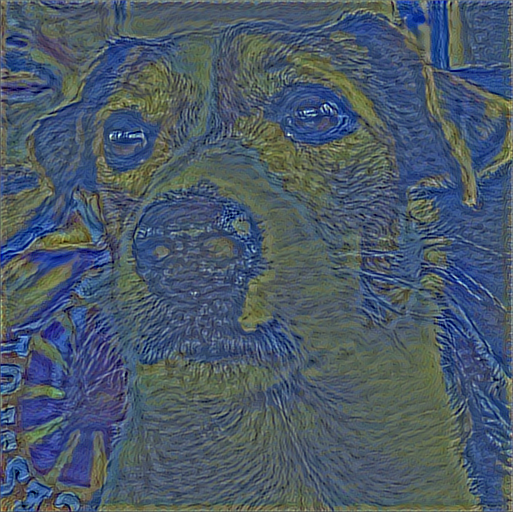

Tempo totale trascorso: 933.8218584060669 secondi

Iterazione 141 completata in 6.528448820114136 secondi
Perdita Stile: 1.928944718084982e-26 Perdita Contenuto: 9.224169345012356e-11
Tempo totale trascorso: 940.4085910320282 secondi

Iterazione 142 completata in 6.460091829299927 secondi
Perdita Stile: 2.155368443852416e-26 Perdita Contenuto: 9.040752868560986e-11
Tempo totale trascorso: 946.8688616752625 secondi

Iterazione 143 completata in 6.481249570846558 secondi
Perdita Stile: 1.9704515898744378e-26 Perdita Contenuto: 9.218750068873405e-11
Tempo totale trascorso: 953.3502850532532 secondi

Iterazione 144 completata in 6.511168003082275 secondi
Perdita Stile: 2.207930461671446e-26 Perdita Contenuto: 9.034607090230296e-11
Tempo totale trascorso: 959.861914396286 secondi

Iterazione 145 completata in 6.539424657821655 secondi
Perdita Stile: 2.011581595692376e-26 Perdita Contenuto: 9.21348553006851e-11
Tempo totale trascorso: 966.4014914035797 secondi

Iterazione 146 completata in 6

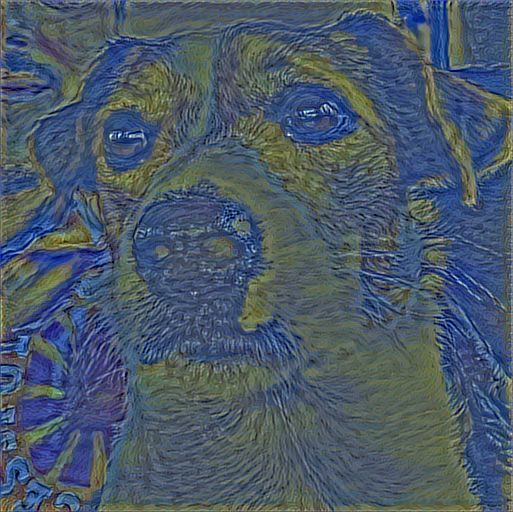

Tempo totale trascorso: 998.8400480747223 secondi

Iterazione 151 completata in 6.560553312301636 secondi
Perdita Stile: 2.132331856527216e-26 Perdita Contenuto: 9.198130451748554e-11
Tempo totale trascorso: 1005.4582805633545 secondi

Iterazione 152 completata in 6.499000310897827 secondi
Perdita Stile: 2.4163245557459e-26 Perdita Contenuto: 9.010758805771957e-11
Tempo totale trascorso: 1011.9574227333069 secondi

Iterazione 153 completata in 6.657487392425537 secondi
Perdita Stile: 2.1718103388992432e-26 Perdita Contenuto: 9.193040079180648e-11
Tempo totale trascorso: 1018.6150667667389 secondi

Iterazione 154 completata in 6.507388591766357 secondi
Perdita Stile: 2.4680382399430262e-26 Perdita Contenuto: 9.004908624321573e-11
Tempo totale trascorso: 1025.1226134300232 secondi

Iterazione 155 completata in 6.469215631484985 secondi
Perdita Stile: 2.21089577748822e-26 Perdita Contenuto: 9.187908767138708e-11
Tempo totale trascorso: 1031.5920233726501 secondi

Iterazione 156 completata

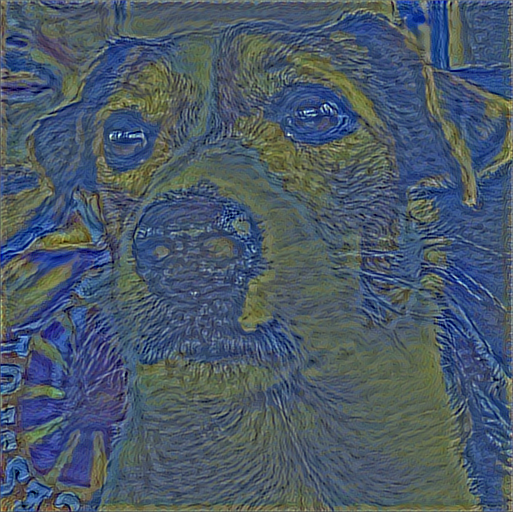

Tempo totale trascorso: 1064.1608724594116 secondi

Iterazione 161 completata in 6.518049955368042 secondi
Perdita Stile: 2.3257768823733364e-26 Perdita Contenuto: 9.172908266297242e-11
Tempo totale trascorso: 1070.736979007721 secondi

Iterazione 162 completata in 6.481039762496948 secondi
Perdita Stile: 2.672924522253971e-26 Perdita Contenuto: 8.982460608653042e-11
Tempo totale trascorso: 1077.2181932926178 secondi

Iterazione 163 completata in 6.448969125747681 secondi
Perdita Stile: 2.363140539592031e-26 Perdita Contenuto: 9.168017733873768e-11
Tempo totale trascorso: 1083.6673350334167 secondi

Iterazione 164 completata in 6.458911895751953 secondi
Perdita Stile: 2.72365875551858e-26 Perdita Contenuto: 8.976885901290643e-11
Tempo totale trascorso: 1090.1264407634735 secondi

Iterazione 165 completata in 6.502568244934082 secondi
Perdita Stile: 2.400262454084106e-26 Perdita Contenuto: 9.163166753145546e-11
Tempo totale trascorso: 1096.6291813850403 secondi

Iterazione 166 completat

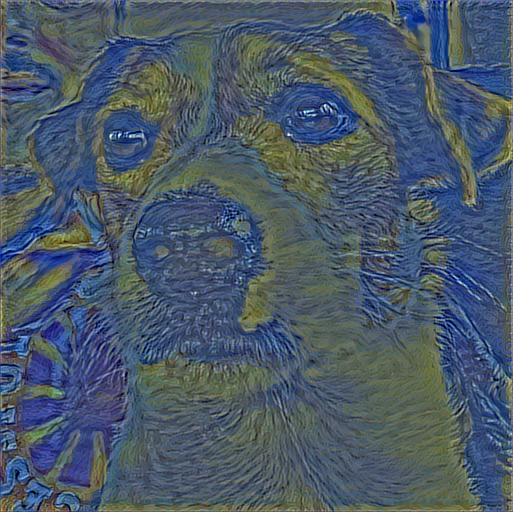

Tempo totale trascorso: 1129.2997415065765 secondi

Iterazione 171 completata in 6.542567014694214 secondi
Perdita Stile: 2.50935436763079e-26 Perdita Contenuto: 9.14861172929271e-11
Tempo totale trascorso: 1135.901022195816 secondi

Iterazione 172 completata in 6.766862869262695 secondi
Perdita Stile: 2.924879299810576e-26 Perdita Contenuto: 8.95523100119533e-11
Tempo totale trascorso: 1142.6680493354797 secondi

Iterazione 173 completata in 6.516404628753662 secondi
Perdita Stile: 2.5449241366620846e-26 Perdita Contenuto: 9.143819035273282e-11
Tempo totale trascorso: 1149.1846163272858 secondi

Iterazione 174 completata in 6.540257453918457 secondi
Perdita Stile: 2.9748456262877584e-26 Perdita Contenuto: 8.949968544058606e-11
Tempo totale trascorso: 1155.7250573635101 secondi

Iterazione 175 completata in 6.523359298706055 secondi
Perdita Stile: 2.5802618696536793e-26 Perdita Contenuto: 9.139069362396057e-11
Tempo totale trascorso: 1162.2485921382904 secondi

Iterazione 176 completat

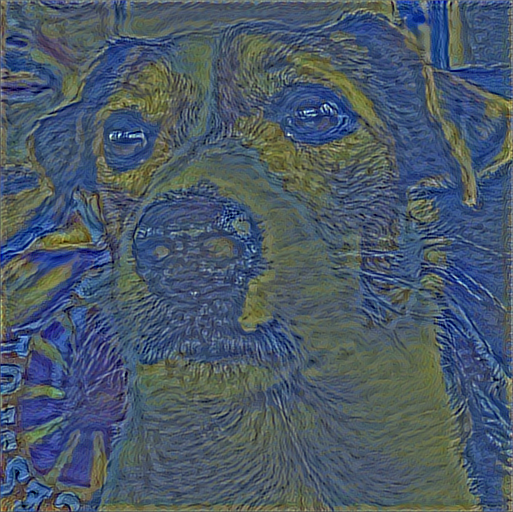

Tempo totale trascorso: 1194.726214170456 secondi

Iterazione 181 completata in 6.539085388183594 secondi
Perdita Stile: 2.684009558716282e-26 Perdita Contenuto: 9.125074307281267e-11
Tempo totale trascorso: 1201.3229351043701 secondi

Iterazione 182 completata in 6.491526126861572 secondi
Perdita Stile: 3.1724142992564053e-26 Perdita Contenuto: 8.929559175419044e-11
Tempo totale trascorso: 1207.8146121501923 secondi

Iterazione 183 completata in 6.500108480453491 secondi
Perdita Stile: 2.7178332026227973e-26 Perdita Contenuto: 9.120436350595895e-11
Tempo totale trascorso: 1214.3148641586304 secondi

Iterazione 184 completata in 6.457017421722412 secondi
Perdita Stile: 3.2213517169200984e-26 Perdita Contenuto: 8.924522926223588e-11
Tempo totale trascorso: 1220.772246837616 secondi

Iterazione 185 completata in 6.498546123504639 secondi
Perdita Stile: 2.7513064813538297e-26 Perdita Contenuto: 9.115860843955659e-11
Tempo totale trascorso: 1227.2709774971008 secondi

Iterazione 186 comple

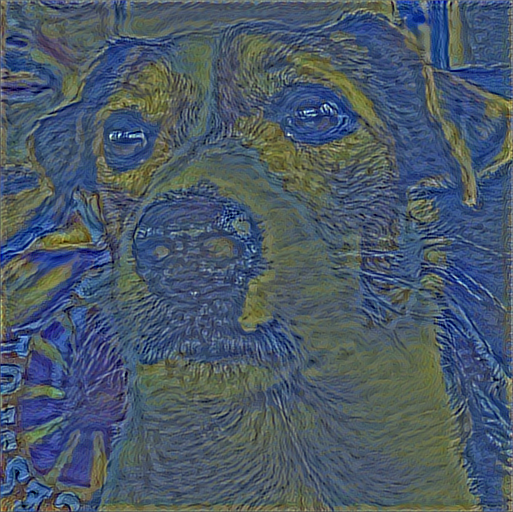

Tempo totale trascorso: 1260.1174366474152 secondi

Iterazione 191 completata in 6.544898748397827 secondi
Perdita Stile: 2.849548013742627e-26 Perdita Contenuto: 9.102094772339697e-11
Tempo totale trascorso: 1266.7199223041534 secondi

Iterazione 192 completata in 6.486979246139526 secondi
Perdita Stile: 3.41442511532415e-26 Perdita Contenuto: 8.904806753085026e-11
Tempo totale trascorso: 1273.207079410553 secondi

Iterazione 193 completata in 6.477283477783203 secondi
Perdita Stile: 2.881394883154223e-26 Perdita Contenuto: 9.097647635236683e-11
Tempo totale trascorso: 1279.6845378875732 secondi

Iterazione 194 completata in 6.543912887573242 secondi
Perdita Stile: 3.4620522843280774e-26 Perdita Contenuto: 8.900075121331952e-11
Tempo totale trascorso: 1286.2286403179169 secondi

Iterazione 195 completata in 6.4881591796875 secondi
Perdita Stile: 2.912968116439321e-26 Perdita Contenuto: 9.093197028686717e-11
Tempo totale trascorso: 1292.7169797420502 secondi

Iterazione 196 completata 

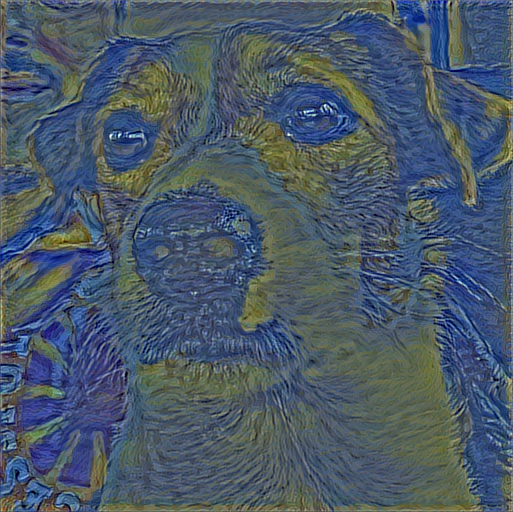

Tempo totale trascorso: 1325.3225700855255 secondi

Iterazione 201 completata in 6.535425186157227 secondi
Perdita Stile: 3.0056075038058847e-26 Perdita Contenuto: 9.079841739589867e-11
Tempo totale trascorso: 1331.9177763462067 secondi

Iterazione 202 completata in 6.492472887039185 secondi
Perdita Stile: 3.6497090432821387e-26 Perdita Contenuto: 8.881131940974285e-11
Tempo totale trascorso: 1338.4104280471802 secondi

Iterazione 203 completata in 6.446131706237793 secondi
Perdita Stile: 3.03572596664819e-26 Perdita Contenuto: 9.075517420908952e-11
Tempo totale trascorso: 1344.8568940162659 secondi

Iterazione 204 completata in 6.4859349727630615 secondi
Perdita Stile: 3.6960894422772677e-26 Perdita Contenuto: 8.876588353246007e-11
Tempo totale trascorso: 1351.3429696559906 secondi

Iterazione 205 completata in 6.464910268783569 secondi
Perdita Stile: 3.0655945208209117e-26 Perdita Contenuto: 9.07119934723255e-11
Tempo totale trascorso: 1357.8080217838287 secondi

Iterazione 206 compl

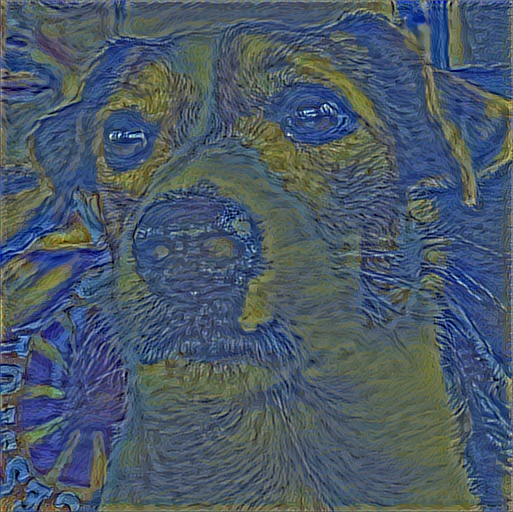

Tempo totale trascorso: 1390.574958562851 secondi

Iterazione 211 completata in 6.535486459732056 secondi
Perdita Stile: 3.1534739338113235e-26 Perdita Contenuto: 9.058194472277847e-11
Tempo totale trascorso: 1397.1725578308105 secondi

Iterazione 212 completata in 6.499225378036499 secondi
Perdita Stile: 3.8784583679760194e-26 Perdita Contenuto: 8.858517391852061e-11
Tempo totale trascorso: 1403.671941280365 secondi

Iterazione 213 completata in 6.509249925613403 secondi
Perdita Stile: 3.1820202215214267e-26 Perdita Contenuto: 9.053953420323779e-11
Tempo totale trascorso: 1410.1813428401947 secondi

Iterazione 214 completata in 6.526803970336914 secondi
Perdita Stile: 3.923440695905919e-26 Perdita Contenuto: 8.854143807024428e-11
Tempo totale trascorso: 1416.7084829807281 secondi

Iterazione 215 completata in 6.470721006393433 secondi
Perdita Stile: 3.2103206064962305e-26 Perdita Contenuto: 9.049724164489348e-11
Tempo totale trascorso: 1423.1793467998505 secondi

Iterazione 216 comple

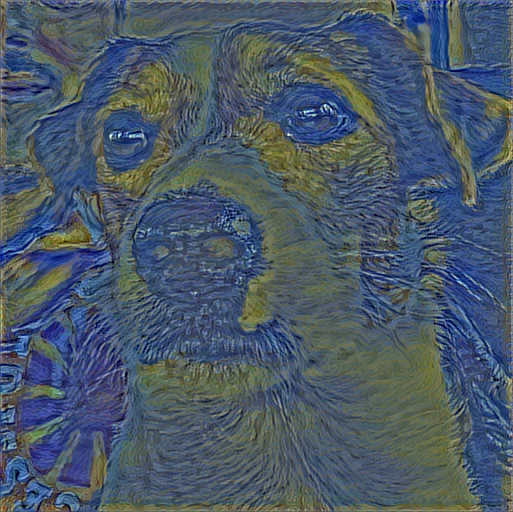

Tempo totale trascorso: 1455.6657543182373 secondi

Iterazione 221 completata in 6.536827325820923 secondi
Perdita Stile: 3.292898627684524e-26 Perdita Contenuto: 9.037254972144027e-11
Tempo totale trascorso: 1462.2604248523712 secondi

Iterazione 222 completata in 6.55222749710083 secondi
Perdita Stile: 4.0998860773933176e-26 Perdita Contenuto: 8.836818082835762e-11
Tempo totale trascorso: 1468.8128082752228 secondi

Iterazione 223 completata in 6.461074113845825 secondi
Perdita Stile: 3.319814500140907e-26 Perdita Contenuto: 9.033102044142538e-11
Tempo totale trascorso: 1475.274332523346 secondi

Iterazione 224 completata in 6.508561372756958 secondi
Perdita Stile: 4.1432324433912567e-26 Perdita Contenuto: 8.832708869865868e-11
Tempo totale trascorso: 1481.7830820083618 secondi

Iterazione 225 completata in 6.476743459701538 secondi
Perdita Stile: 3.3463639836846694e-26 Perdita Contenuto: 9.02893176890629e-11
Tempo totale trascorso: 1488.2603149414062 secondi

Iterazione 226 completa

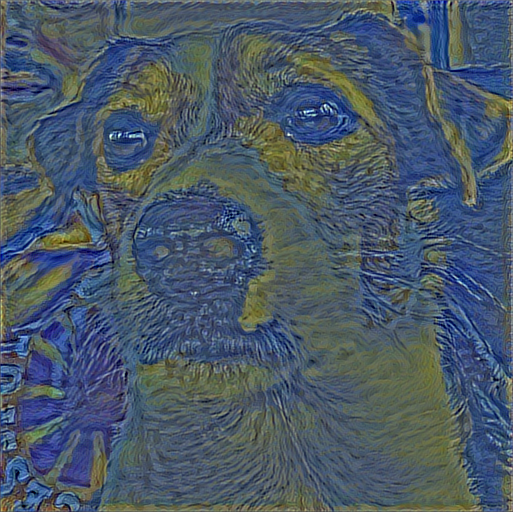

Tempo totale trascorso: 1521.0951352119446 secondi

Iterazione 231 completata in 6.500317811965942 secondi
Perdita Stile: 3.4243462738024685e-26 Perdita Contenuto: 9.01681992959702e-11
Tempo totale trascorso: 1527.6529431343079 secondi

Iterazione 232 completata in 6.487899541854858 secondi
Perdita Stile: 4.313912052848347e-26 Perdita Contenuto: 8.816060381722224e-11
Tempo totale trascorso: 1534.1410191059113 secondi

Iterazione 233 completata in 6.461554527282715 secondi
Perdita Stile: 3.44985236553956e-26 Perdita Contenuto: 9.012871698965697e-11
Tempo totale trascorso: 1540.6027500629425 secondi

Iterazione 234 completata in 6.51337456703186 secondi
Perdita Stile: 4.355723837866598e-26 Perdita Contenuto: 8.811975454880994e-11
Tempo totale trascorso: 1547.1163115501404 secondi

Iterazione 235 completata in 6.527975559234619 secondi
Perdita Stile: 3.475079582620704e-26 Perdita Contenuto: 9.008921386666202e-11
Tempo totale trascorso: 1553.6444256305695 secondi

Iterazione 236 completata

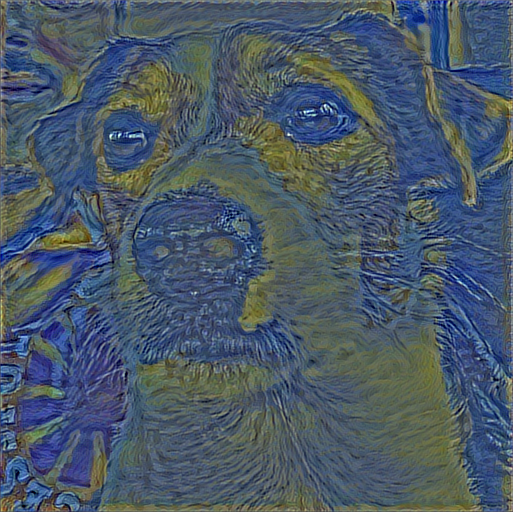

Tempo totale trascorso: 1586.161775112152 secondi

Iterazione 241 completata in 6.55058217048645 secondi
Perdita Stile: 3.54904546139528e-26 Perdita Contenuto: 8.997260575460686e-11
Tempo totale trascorso: 1592.7720551490784 secondi

Iterazione 242 completata in 6.477423429489136 secondi
Perdita Stile: 4.519431272776215e-26 Perdita Contenuto: 8.796186001802653e-11
Tempo totale trascorso: 1599.249811410904 secondi

Iterazione 243 completata in 6.5174243450164795 secondi
Perdita Stile: 3.573115887914627e-26 Perdita Contenuto: 8.9934323876939e-11
Tempo totale trascorso: 1605.767392873764 secondi

Iterazione 244 completata in 6.4690632820129395 secondi
Perdita Stile: 4.559705395326868e-26 Perdita Contenuto: 8.792364059040381e-11
Tempo totale trascorso: 1612.2368395328522 secondi

Iterazione 245 completata in 6.7915894985198975 secondi
Perdita Stile: 3.596847350763762e-26 Perdita Contenuto: 8.989713834450797e-11
Tempo totale trascorso: 1619.0286092758179 secondi

Iterazione 246 completata i

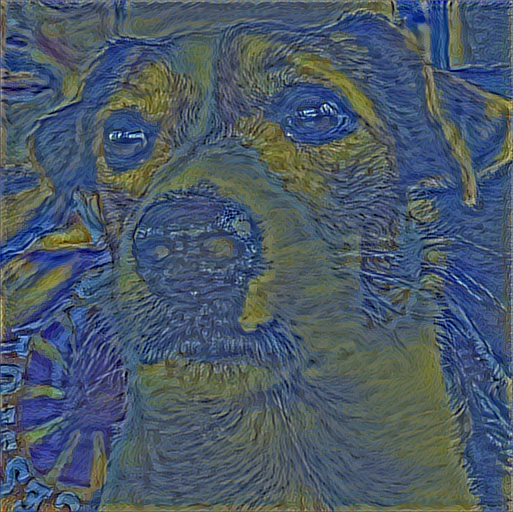

Tempo totale trascorso: 1651.5442054271698 secondi

Iterazione 251 completata in 6.486597061157227 secondi
Perdita Stile: 3.666439057448646e-26 Perdita Contenuto: 8.978539439707944e-11
Tempo totale trascorso: 1658.088235616684 secondi

Iterazione 252 completata in 6.516199111938477 secondi
Perdita Stile: 4.717444296301631e-26 Perdita Contenuto: 8.777331639286956e-11
Tempo totale trascorso: 1664.6049580574036 secondi

Iterazione 253 completata in 6.491784334182739 secondi
Perdita Stile: 3.689124047003199e-26 Perdita Contenuto: 8.97494509266572e-11
Tempo totale trascorso: 1671.0969185829163 secondi

Iterazione 254 completata in 6.527870416641235 secondi
Perdita Stile: 4.756048252404511e-26 Perdita Contenuto: 8.773726190014486e-11
Tempo totale trascorso: 1677.6249647140503 secondi

Iterazione 255 completata in 6.485994100570679 secondi
Perdita Stile: 3.711637397681108e-26 Perdita Contenuto: 8.971345194508373e-11
Tempo totale trascorso: 1684.1111340522766 secondi

Iterazione 256 completata

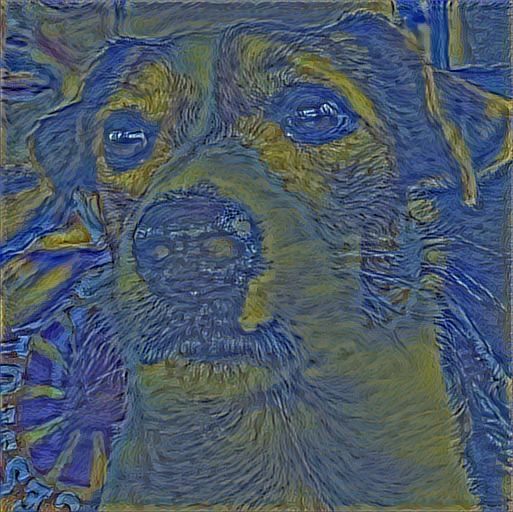

Tempo totale trascorso: 1717.2641570568085 secondi

Iterazione 261 completata in 6.611439943313599 secondi
Perdita Stile: 3.7778329965392573e-26 Perdita Contenuto: 8.960704400706732e-11
Tempo totale trascorso: 1723.9323070049286 secondi

Iterazione 262 completata in 6.512162685394287 secondi
Perdita Stile: 4.9073049354096537e-26 Perdita Contenuto: 8.759282882353503e-11
Tempo totale trascorso: 1730.4446368217468 secondi

Iterazione 263 completata in 6.5005598068237305 secondi
Perdita Stile: 3.7993436310509206e-26 Perdita Contenuto: 8.957250913210757e-11
Tempo totale trascorso: 1736.9453446865082 secondi

Iterazione 264 completata in 6.869999408721924 secondi
Perdita Stile: 4.944396497245805e-26 Perdita Contenuto: 8.755858538211925e-11
Tempo totale trascorso: 1743.8154845237732 secondi

Iterazione 265 completata in 6.523991346359253 secondi
Perdita Stile: 3.820712517118677e-26 Perdita Contenuto: 8.953709995651593e-11
Tempo totale trascorso: 1750.3396620750427 secondi

Iterazione 266 comp

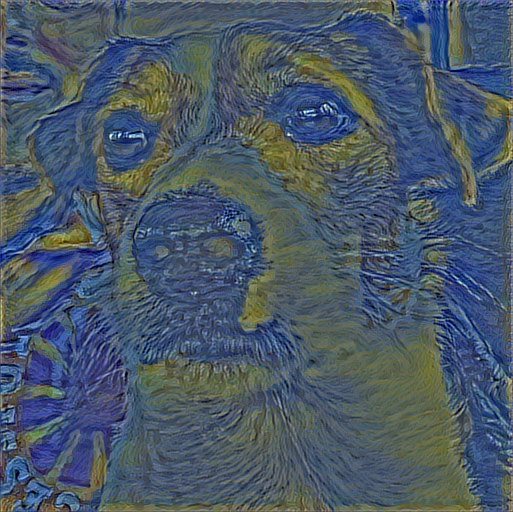

Tempo totale trascorso: 1782.9355962276459 secondi

Iterazione 271 completata in 6.592535972595215 secondi
Perdita Stile: 3.883519711869869e-26 Perdita Contenuto: 8.943758234014609e-11
Tempo totale trascorso: 1789.5850520133972 secondi

Iterazione 272 completata in 6.5650389194488525 secondi
Perdita Stile: 5.0890125738027006e-26 Perdita Contenuto: 8.742305490638813e-11
Tempo totale trascorso: 1796.1502659320831 secondi

Iterazione 273 completata in 6.538687467575073 secondi
Perdita Stile: 3.903984181235741e-26 Perdita Contenuto: 8.940442136617932e-11
Tempo totale trascorso: 1802.6891119480133 secondi

Iterazione 274 completata in 6.484041452407837 secondi
Perdita Stile: 5.1243125585673854e-26 Perdita Contenuto: 8.738999107693601e-11
Tempo totale trascorso: 1809.1733105182648 secondi

Iterazione 275 completata in 6.514003276824951 secondi
Perdita Stile: 3.9242890295278225e-26 Perdita Contenuto: 8.937130896446988e-11
Tempo totale trascorso: 1815.6874651908875 secondi

Iterazione 276 comp

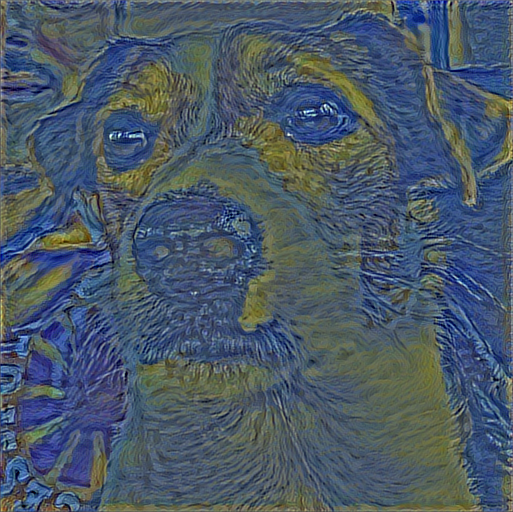

Tempo totale trascorso: 1848.3865683078766 secondi

Iterazione 281 completata in 6.522398948669434 secondi
Perdita Stile: 3.983616608129891e-26 Perdita Contenuto: 8.927533712288493e-11
Tempo totale trascorso: 1854.9660050868988 secondi

Iterazione 282 completata in 6.9828479290008545 secondi
Perdita Stile: 5.262417143019505e-26 Perdita Contenuto: 8.726275951831397e-11
Tempo totale trascorso: 1861.9490284919739 secondi

Iterazione 283 completata in 6.534297704696655 secondi
Perdita Stile: 4.003009336000311e-26 Perdita Contenuto: 8.924504885099438e-11
Tempo totale trascorso: 1868.4835042953491 secondi

Iterazione 284 completata in 6.5441789627075195 secondi
Perdita Stile: 5.296163749728245e-26 Perdita Contenuto: 8.723141653455002e-11
Tempo totale trascorso: 1875.0278718471527 secondi

Iterazione 285 completata in 6.504385471343994 secondi
Perdita Stile: 4.022134590720054e-26 Perdita Contenuto: 8.921387240068412e-11
Tempo totale trascorso: 1881.5324292182922 secondi

Iterazione 286 comple

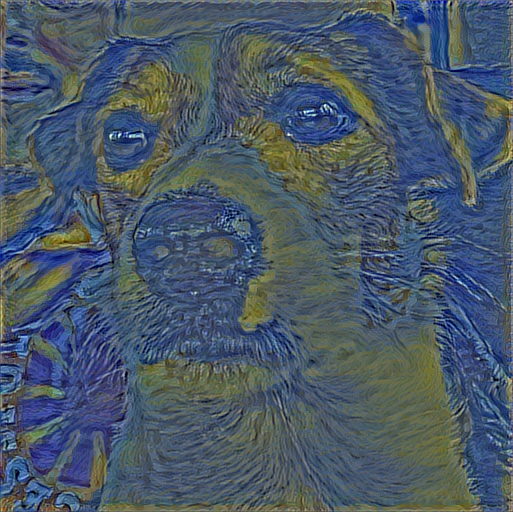

Tempo totale trascorso: 1914.0412480831146 secondi

Iterazione 291 completata in 6.526565790176392 secondi
Perdita Stile: 4.078791751898433e-26 Perdita Contenuto: 8.912150184503531e-11
Tempo totale trascorso: 1920.6260302066803 secondi

Iterazione 292 completata in 6.491894960403442 secondi
Perdita Stile: 5.42779628512085e-26 Perdita Contenuto: 8.71077723840763e-11
Tempo totale trascorso: 1927.1180801391602 secondi

Iterazione 293 completata in 6.561264276504517 secondi
Perdita Stile: 4.0972199740527034e-26 Perdita Contenuto: 8.909152582337043e-11
Tempo totale trascorso: 1933.6795127391815 secondi

Iterazione 294 completata in 6.676968574523926 secondi
Perdita Stile: 5.459810479326015e-26 Perdita Contenuto: 8.7077754729048e-11
Tempo totale trascorso: 1940.356620311737 secondi

Iterazione 295 completata in 7.1042327880859375 secondi
Perdita Stile: 4.11539551419827e-26 Perdita Contenuto: 8.906206327985444e-11
Tempo totale trascorso: 1947.4610152244568 secondi

Iterazione 296 completata i

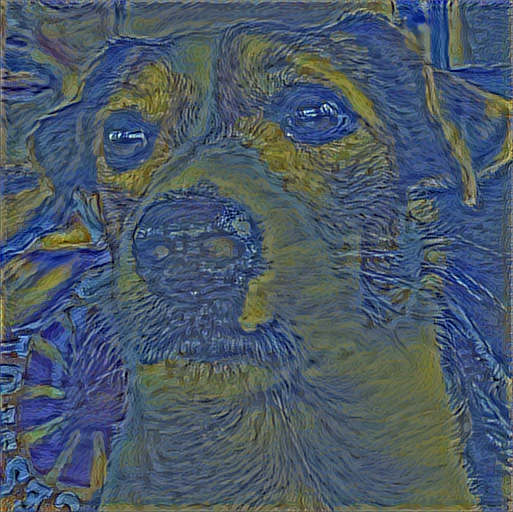

Tempo totale trascorso: 1980.4597234725952 secondi

Iterazione 301 completata in 6.525193691253662 secondi
Perdita Stile: 4.169201066463792e-26 Perdita Contenuto: 8.897413361630413e-11
Tempo totale trascorso: 1987.0416750907898 secondi

Iterazione 302 completata in 6.471702814102173 secondi
Perdita Stile: 5.585273259623177e-26 Perdita Contenuto: 8.696211112324548e-11
Tempo totale trascorso: 1993.5135536193848 secondi

Iterazione 303 completata in 6.494647264480591 secondi
Perdita Stile: 4.186752605307377e-26 Perdita Contenuto: 8.894502495637724e-11
Tempo totale trascorso: 2000.008382320404 secondi

Iterazione 304 completata in 6.467757940292358 secondi
Perdita Stile: 5.615796629976991e-26 Perdita Contenuto: 8.693405023629808e-11
Tempo totale trascorso: 2006.476345539093 secondi

Iterazione 305 completata in 6.496587038040161 secondi
Perdita Stile: 4.204178727592984e-26 Perdita Contenuto: 8.891589547976864e-11
Tempo totale trascorso: 2012.9732954502106 secondi

Iterazione 306 completata

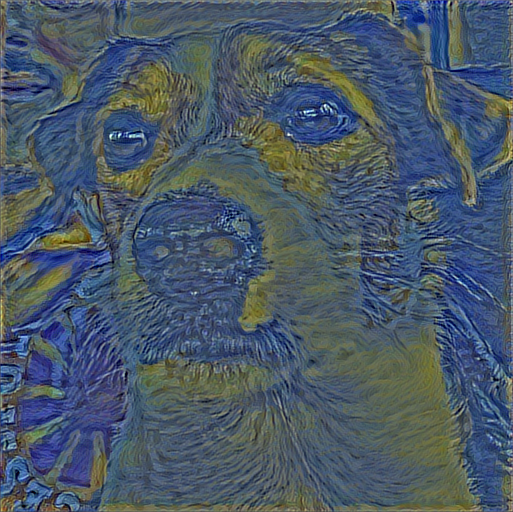

Tempo totale trascorso: 2045.5515503883362 secondi

Iterazione 311 completata in 6.534590482711792 secondi
Perdita Stile: 4.255448831605319e-26 Perdita Contenuto: 8.883251079172538e-11
Tempo totale trascorso: 2052.142599582672 secondi

Iterazione 312 completata in 6.463287591934204 secondi
Perdita Stile: 5.735243113276678e-26 Perdita Contenuto: 8.682248670011106e-11
Tempo totale trascorso: 2058.6060626506805 secondi

Iterazione 313 completata in 6.477328062057495 secondi
Perdita Stile: 4.2722663600284993e-26 Perdita Contenuto: 8.880481072726099e-11
Tempo totale trascorso: 2065.0835564136505 secondi

Iterazione 314 completata in 6.499462366104126 secondi
Perdita Stile: 5.764496910611151e-26 Perdita Contenuto: 8.679472418560152e-11
Tempo totale trascorso: 2071.583171606064 secondi

Iterazione 315 completata in 6.561266660690308 secondi
Perdita Stile: 4.2890466024479564e-26 Perdita Contenuto: 8.877776291882356e-11
Tempo totale trascorso: 2078.1446092128754 secondi

Iterazione 316 completa

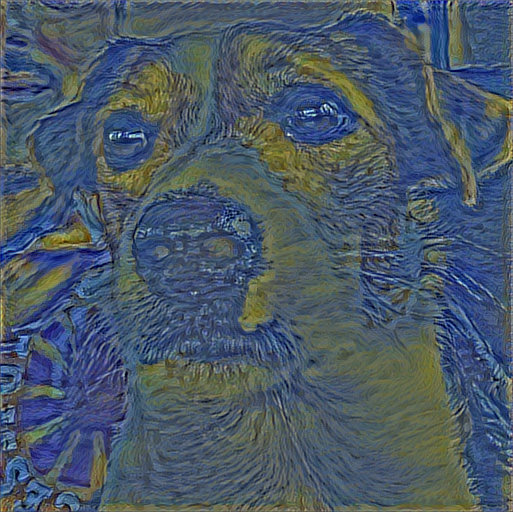

Tempo totale trascorso: 2111.0695493221283 secondi

Iterazione 321 completata in 6.522343635559082 secondi
Perdita Stile: 4.338184624974657e-26 Perdita Contenuto: 8.869600887084772e-11
Tempo totale trascorso: 2117.649022102356 secondi

Iterazione 322 completata in 6.4885783195495605 secondi
Perdita Stile: 5.878002901515975e-26 Perdita Contenuto: 8.66890101369755e-11
Tempo totale trascorso: 2124.137776851654 secondi

Iterazione 323 completata in 6.510820388793945 secondi
Perdita Stile: 4.354303271939618e-26 Perdita Contenuto: 8.866975903520924e-11
Tempo totale trascorso: 2130.648789167404 secondi

Iterazione 324 completata in 6.49259877204895 secondi
Perdita Stile: 5.905662337005287e-26 Perdita Contenuto: 8.666305173488098e-11
Tempo totale trascorso: 2137.141530275345 secondi

Iterazione 325 completata in 6.44366979598999 secondi
Perdita Stile: 4.370454582676436e-26 Perdita Contenuto: 8.864362022187322e-11
Tempo totale trascorso: 2143.5853571891785 secondi

Iterazione 326 completata in 

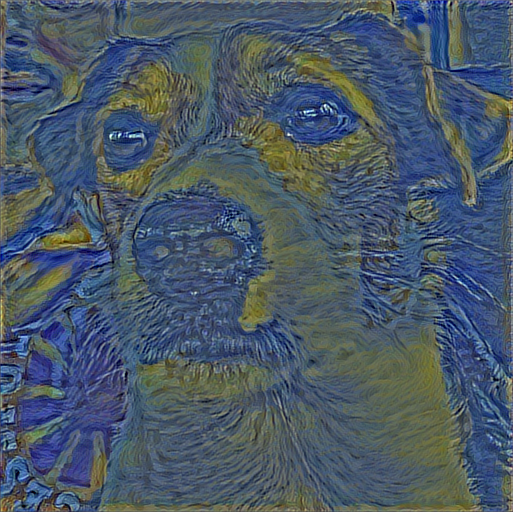

Tempo totale trascorso: 2176.119563102722 secondi

Iterazione 331 completata in 6.496394872665405 secondi
Perdita Stile: 4.4176651345147937e-26 Perdita Contenuto: 8.85661613492239e-11
Tempo totale trascorso: 2182.673038959503 secondi

Iterazione 332 completata in 6.4934401512146 secondi
Perdita Stile: 6.013712861712442e-26 Perdita Contenuto: 8.656107775006916e-11
Tempo totale trascorso: 2189.1666457653046 secondi

Iterazione 333 completata in 6.481031179428101 secondi
Perdita Stile: 4.433198298776661e-26 Perdita Contenuto: 8.85414727647138e-11
Tempo totale trascorso: 2195.647864818573 secondi

Iterazione 334 completata in 6.4952476024627686 secondi
Perdita Stile: 6.039912288229512e-26 Perdita Contenuto: 8.653629895993831e-11
Tempo totale trascorso: 2202.1432824134827 secondi

Iterazione 335 completata in 6.50583815574646 secondi
Perdita Stile: 4.4485462656150764e-26 Perdita Contenuto: 8.85151812957119e-11
Tempo totale trascorso: 2208.6492965221405 secondi

Iterazione 336 completata in 

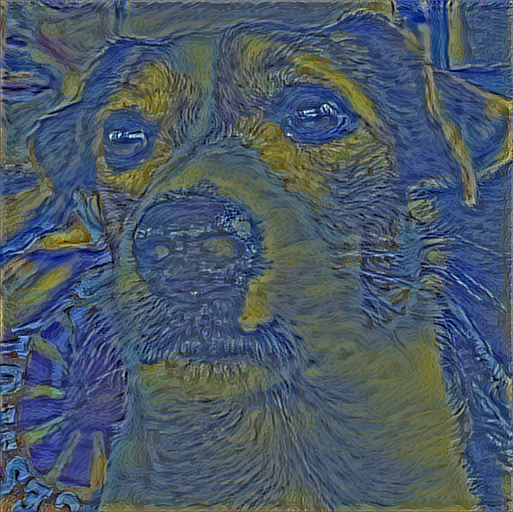

Tempo totale trascorso: 2241.6093554496765 secondi

Iterazione 341 completata in 6.573513984680176 secondi
Perdita Stile: 4.4939877352437177e-26 Perdita Contenuto: 8.84411363588633e-11
Tempo totale trascorso: 2248.2429881095886 secondi

Iterazione 342 completata in 6.487260103225708 secondi
Perdita Stile: 6.142668200407954e-26 Perdita Contenuto: 8.643839810584808e-11
Tempo totale trascorso: 2254.7304270267487 secondi

Iterazione 343 completata in 6.515394926071167 secondi
Perdita Stile: 4.509011837702685e-26 Perdita Contenuto: 8.841729431940948e-11
Tempo totale trascorso: 2261.246257543564 secondi

Iterazione 344 completata in 6.483888149261475 secondi
Perdita Stile: 6.16748218996023e-26 Perdita Contenuto: 8.641491688887726e-11
Tempo totale trascorso: 2267.730301618576 secondi

Iterazione 345 completata in 6.494439363479614 secondi
Perdita Stile: 4.5237847988969037e-26 Perdita Contenuto: 8.839339676880442e-11
Tempo totale trascorso: 2274.2249178886414 secondi

Iterazione 346 completata

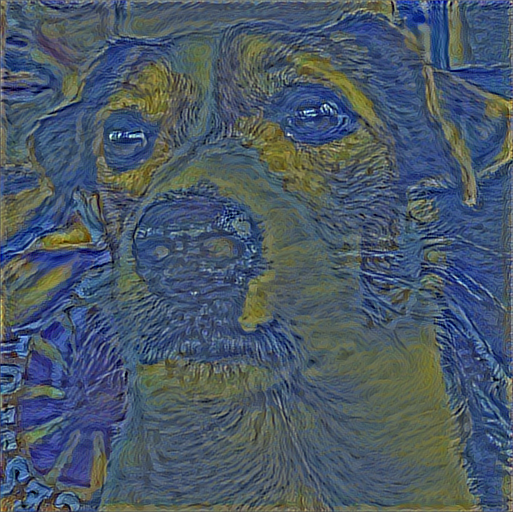

Tempo totale trascorso: 2306.6848890781403 secondi

Iterazione 351 completata in 6.507883787155151 secondi
Perdita Stile: 4.56756103245843e-26 Perdita Contenuto: 8.832344577935913e-11
Tempo totale trascorso: 2313.24955701828 secondi

Iterazione 352 completata in 6.474557399749756 secondi
Perdita Stile: 6.265263964352703e-26 Perdita Contenuto: 8.632362186178355e-11
Tempo totale trascorso: 2319.7242538928986 secondi

Iterazione 353 completata in 6.5137410163879395 secondi
Perdita Stile: 4.581997803321557e-26 Perdita Contenuto: 8.830034620155303e-11
Tempo totale trascorso: 2326.2381613254547 secondi

Iterazione 354 completata in 6.466548204421997 secondi
Perdita Stile: 6.289109750403337e-26 Perdita Contenuto: 8.630073738968846e-11
Tempo totale trascorso: 2332.7048835754395 secondi

Iterazione 355 completata in 6.910366535186768 secondi
Perdita Stile: 4.596278342747595e-26 Perdita Contenuto: 8.827807235212148e-11
Tempo totale trascorso: 2339.6154279708862 secondi

Iterazione 356 completata

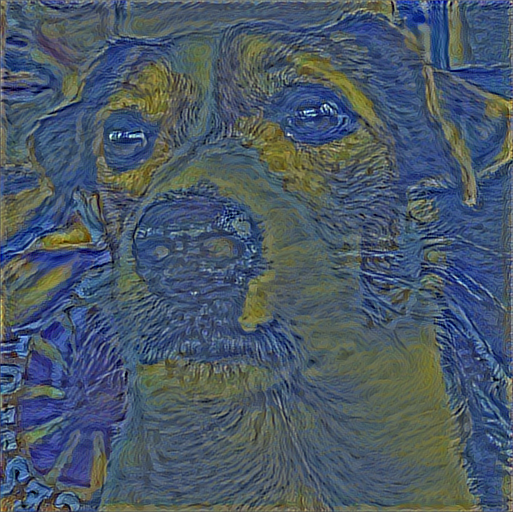

Tempo totale trascorso: 2372.151965856552 secondi

Iterazione 361 completata in 6.544020175933838 secondi
Perdita Stile: 4.638554507994037e-26 Perdita Contenuto: 8.820978669721313e-11
Tempo totale trascorso: 2378.7525792121887 secondi

Iterazione 362 completata in 6.51190710067749 secondi
Perdita Stile: 6.382217523932376e-26 Perdita Contenuto: 8.62118293420977e-11
Tempo totale trascorso: 2385.2646567821503 secondi

Iterazione 363 completata in 6.537290811538696 secondi
Perdita Stile: 4.652434145842851e-26 Perdita Contenuto: 8.818707569746564e-11
Tempo totale trascorso: 2391.802128791809 secondi

Iterazione 364 completata in 6.562983512878418 secondi
Perdita Stile: 6.405078466446648e-26 Perdita Contenuto: 8.618966651496862e-11
Tempo totale trascorso: 2398.3652832508087 secondi

Iterazione 365 completata in 6.486431121826172 secondi
Perdita Stile: 4.666248764296743e-26 Perdita Contenuto: 8.816541247069765e-11
Tempo totale trascorso: 2404.8518941402435 secondi

Iterazione 366 completata i

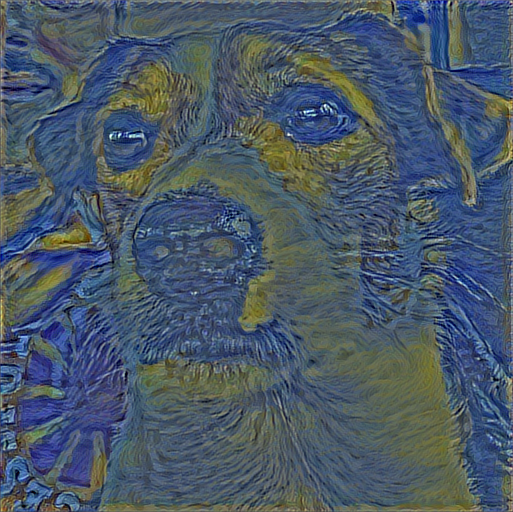

Tempo totale trascorso: 2437.335762023926 secondi

Iterazione 371 completata in 6.554499387741089 secondi
Perdita Stile: 4.707026093823265e-26 Perdita Contenuto: 8.809869500581158e-11
Tempo totale trascorso: 2443.9497439861298 secondi

Iterazione 372 completata in 6.507185935974121 secondi
Perdita Stile: 6.494142095241264e-26 Perdita Contenuto: 8.61040405641944e-11
Tempo totale trascorso: 2450.4571034908295 secondi

Iterazione 373 completata in 6.471589803695679 secondi
Perdita Stile: 4.720462921859266e-26 Perdita Contenuto: 8.807667789545448e-11
Tempo totale trascorso: 2456.9288856983185 secondi

Iterazione 374 completata in 7.054447889328003 secondi
Perdita Stile: 6.515831456051767e-26 Perdita Contenuto: 8.60828908155753e-11
Tempo totale trascorso: 2463.9835131168365 secondi

Iterazione 375 completata in 6.52070164680481 secondi
Perdita Stile: 4.733765088873555e-26 Perdita Contenuto: 8.80561110139233e-11
Tempo totale trascorso: 2470.5043482780457 secondi

Iterazione 376 completata in

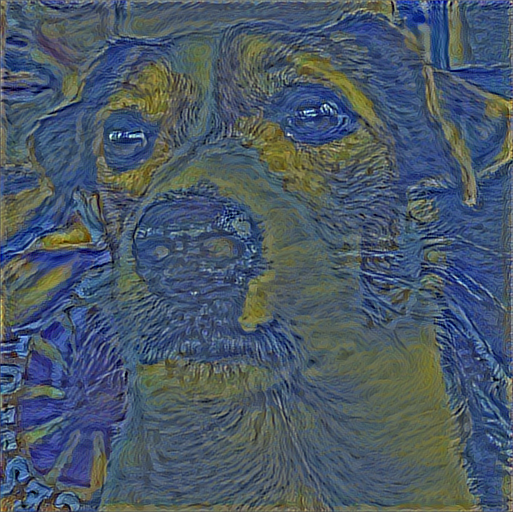

Tempo totale trascorso: 2503.0725173950195 secondi

Iterazione 381 completata in 6.5703349113464355 secondi
Perdita Stile: 4.773257746089973e-26 Perdita Contenuto: 8.79939454634382e-11
Tempo totale trascorso: 2509.699405193329 secondi

Iterazione 382 completata in 6.519891977310181 secondi
Perdita Stile: 6.600834916374824e-26 Perdita Contenuto: 8.60019139237167e-11
Tempo totale trascorso: 2516.2194380760193 secondi

Iterazione 383 completata in 6.538165330886841 secondi
Perdita Stile: 4.786347290438402e-26 Perdita Contenuto: 8.797253203685074e-11
Tempo totale trascorso: 2522.7579538822174 secondi

Iterazione 384 completata in 6.541471004486084 secondi
Perdita Stile: 6.62166392576057e-26 Perdita Contenuto: 8.598150663674531e-11
Tempo totale trascorso: 2529.2995977401733 secondi

Iterazione 385 completata in 6.498340129852295 secondi
Perdita Stile: 4.799166588297035e-26 Perdita Contenuto: 8.795261741134652e-11
Tempo totale trascorso: 2535.7981100082397 secondi

Iterazione 386 completata 

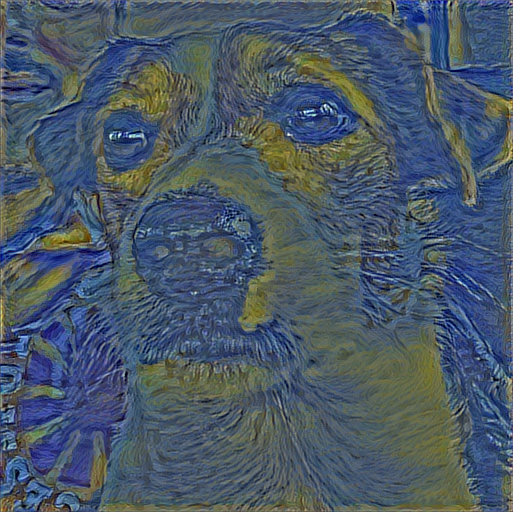

Tempo totale trascorso: 2568.335356235504 secondi

Iterazione 391 completata in 6.524875164031982 secondi
Perdita Stile: 4.837988405595224e-26 Perdita Contenuto: 8.789243638451794e-11
Tempo totale trascorso: 2574.9197092056274 secondi

Iterazione 392 completata in 6.978049039840698 secondi
Perdita Stile: 6.701834380443984e-26 Perdita Contenuto: 8.590241712402857e-11
Tempo totale trascorso: 2581.897920370102 secondi

Iterazione 393 completata in 6.507383346557617 secondi
Perdita Stile: 4.850630517898973e-26 Perdita Contenuto: 8.787257727016495e-11
Tempo totale trascorso: 2588.405484676361 secondi

Iterazione 394 completata in 6.45561957359314 secondi
Perdita Stile: 6.72146653992509e-26 Perdita Contenuto: 8.588314087676352e-11
Tempo totale trascorso: 2594.861280441284 secondi

Iterazione 395 completata in 6.504740238189697 secondi
Perdita Stile: 4.8632331871574606e-26 Perdita Contenuto: 8.78527667280693e-11
Tempo totale trascorso: 2601.3664536476135 secondi

Iterazione 396 completata in 

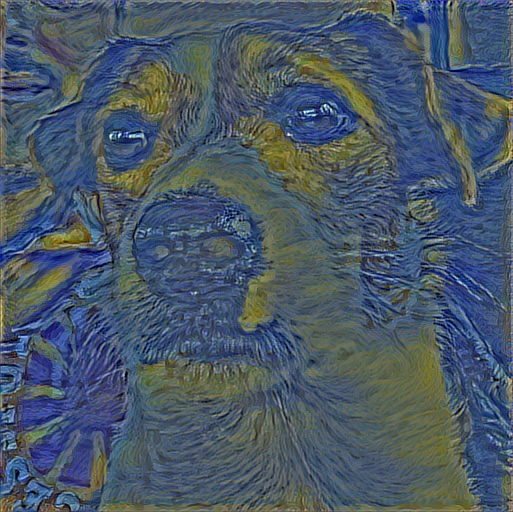

Tempo totale trascorso: 2633.9306321144104 secondi

Iterazione 401 completata in 6.525308609008789 secondi
Perdita Stile: 4.90072965650512e-26 Perdita Contenuto: 8.779499349742537e-11
Tempo totale trascorso: 2640.515226840973 secondi

Iterazione 402 completata in 6.535787582397461 secondi
Perdita Stile: 6.79821038005145e-26 Perdita Contenuto: 8.580720856077306e-11
Tempo totale trascorso: 2647.0511803627014 secondi

Iterazione 403 completata in 6.552762746810913 secondi
Perdita Stile: 4.913029415501955e-26 Perdita Contenuto: 8.777509968860286e-11
Tempo totale trascorso: 2653.604372739792 secondi

Iterazione 404 completata in 6.475496530532837 secondi
Perdita Stile: 6.816728889801513e-26 Perdita Contenuto: 8.578830701377882e-11
Tempo totale trascorso: 2660.0800647735596 secondi

Iterazione 405 completata in 6.526181936264038 secondi
Perdita Stile: 4.9251242555527066e-26 Perdita Contenuto: 8.775602466926102e-11
Tempo totale trascorso: 2666.606409072876 secondi

Iterazione 406 completata i

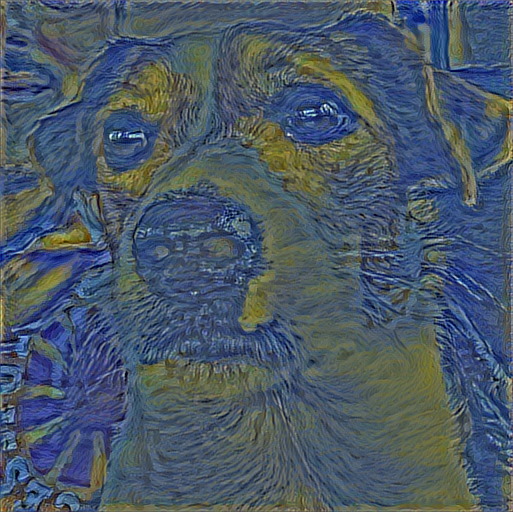

Tempo totale trascorso: 2699.4400510787964 secondi

Iterazione 411 completata in 6.639886140823364 secondi
Perdita Stile: 4.9613067784551074e-26 Perdita Contenuto: 8.769936860053562e-11
Tempo totale trascorso: 2706.137533426285 secondi

Iterazione 412 completata in 6.551872730255127 secondi
Perdita Stile: 6.889717012461923e-26 Perdita Contenuto: 8.571589271699764e-11
Tempo totale trascorso: 2712.689578771591 secondi

Iterazione 413 completata in 6.469648838043213 secondi
Perdita Stile: 4.9733815888344376e-26 Perdita Contenuto: 8.768097359279636e-11
Tempo totale trascorso: 2719.159614801407 secondi

Iterazione 414 completata in 6.469453573226929 secondi
Perdita Stile: 6.907262388329686e-26 Perdita Contenuto: 8.569814996528535e-11
Tempo totale trascorso: 2725.6292107105255 secondi

Iterazione 415 completata in 6.485348463058472 secondi
Perdita Stile: 4.98527243438548e-26 Perdita Contenuto: 8.766240511270951e-11
Tempo totale trascorso: 2732.114748954773 secondi

Iterazione 416 completata 

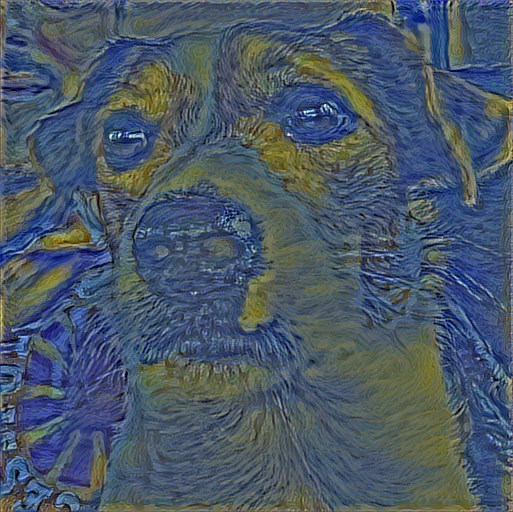

Tempo totale trascorso: 2764.565032720566 secondi

Iterazione 421 completata in 6.536460638046265 secondi
Perdita Stile: 5.020237769563028e-26 Perdita Contenuto: 8.760863562384813e-11
Tempo totale trascorso: 2771.157931804657 secondi

Iterazione 422 completata in 6.503259658813477 secondi
Perdita Stile: 6.977124033355575e-26 Perdita Contenuto: 8.562888592633655e-11
Tempo totale trascorso: 2777.6613445281982 secondi

Iterazione 423 completata in 6.477348327636719 secondi
Perdita Stile: 5.031949272517649e-26 Perdita Contenuto: 8.759126757240665e-11
Tempo totale trascorso: 2784.1388716697693 secondi

Iterazione 424 completata in 6.493541717529297 secondi
Perdita Stile: 6.994168975586589e-26 Perdita Contenuto: 8.561135828033528e-11
Tempo totale trascorso: 2790.6325562000275 secondi

Iterazione 425 completata in 6.531337022781372 secondi
Perdita Stile: 5.04332520143876e-26 Perdita Contenuto: 8.757344849286142e-11
Tempo totale trascorso: 2797.1640486717224 secondi

Iterazione 426 completata 

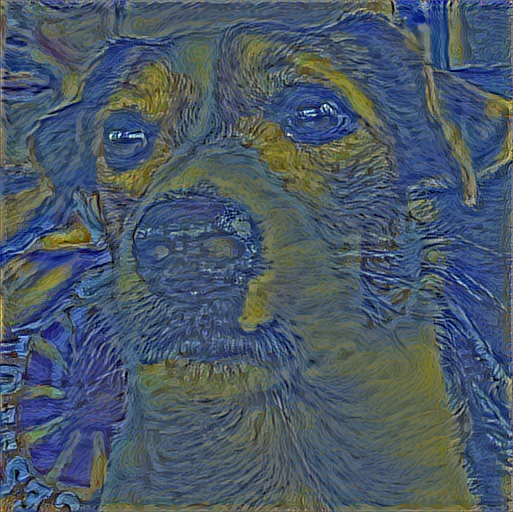

Tempo totale trascorso: 2830.246265888214 secondi

Iterazione 431 completata in 6.4893434047698975 secondi
Perdita Stile: 5.077504449050207e-26 Perdita Contenuto: 8.752178842774683e-11
Tempo totale trascorso: 2836.7921919822693 secondi

Iterazione 432 completata in 6.466203212738037 secondi
Perdita Stile: 7.060429593839661e-26 Perdita Contenuto: 8.55440857039369e-11
Tempo totale trascorso: 2843.2589206695557 secondi

Iterazione 433 completata in 6.5240936279296875 secondi
Perdita Stile: 5.088802416327169e-26 Perdita Contenuto: 8.750400404267111e-11
Tempo totale trascorso: 2849.783202648163 secondi

Iterazione 434 completata in 6.551252126693726 secondi
Perdita Stile: 7.076852691810231e-26 Perdita Contenuto: 8.552748093082485e-11
Tempo totale trascorso: 2856.3346240520477 secondi

Iterazione 435 completata in 6.500734090805054 secondi
Perdita Stile: 5.0998347593462014e-26 Perdita Contenuto: 8.748691354698579e-11
Tempo totale trascorso: 2862.8355751037598 secondi

Iterazione 436 completa

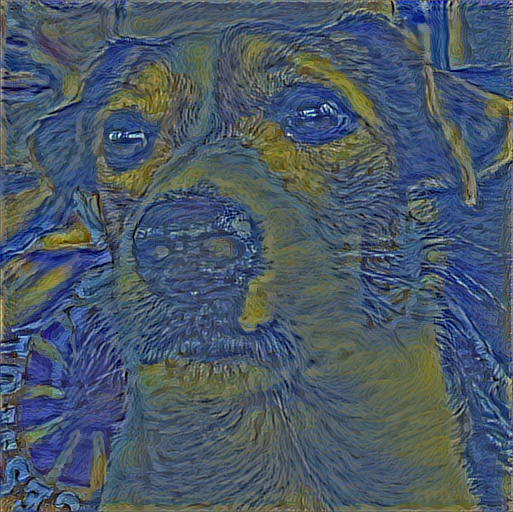

Tempo totale trascorso: 2895.270745038986 secondi

Iterazione 441 completata in 6.518793344497681 secondi
Perdita Stile: 5.133297252869545e-26 Perdita Contenuto: 8.743671758848492e-11
Tempo totale trascorso: 2901.8467049598694 secondi

Iterazione 442 completata in 6.494216442108154 secondi
Perdita Stile: 7.140110708242805e-26 Perdita Contenuto: 8.546135327192061e-11
Tempo totale trascorso: 2908.3411045074463 secondi

Iterazione 443 completata in 6.5193421840667725 secondi
Perdita Stile: 5.144276594296508e-26 Perdita Contenuto: 8.742065404909738e-11
Tempo totale trascorso: 2914.8606209754944 secondi

Iterazione 444 completata in 6.479136943817139 secondi
Perdita Stile: 7.155490414406704e-26 Perdita Contenuto: 8.544517871023061e-11
Tempo totale trascorso: 2921.3399341106415 secondi

Iterazione 445 completata in 6.506325721740723 secondi
Perdita Stile: 5.155161025895811e-26 Perdita Contenuto: 8.74045349985586e-11
Tempo totale trascorso: 2927.8466415405273 secondi

Iterazione 446 completat

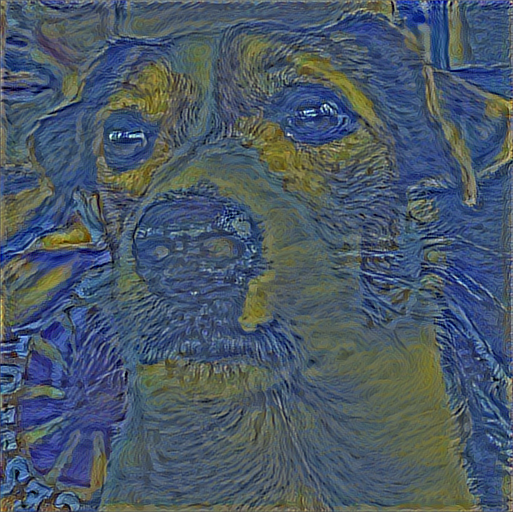

Tempo totale trascorso: 2960.9286291599274 secondi

Iterazione 451 completata in 6.5029137134552 secondi
Perdita Stile: 5.187619570657745e-26 Perdita Contenuto: 8.735511619617498e-11
Tempo totale trascorso: 2967.4875605106354 secondi

Iterazione 452 completata in 6.555102825164795 secondi
Perdita Stile: 7.216198191444118e-26 Perdita Contenuto: 8.538126455848172e-11
Tempo totale trascorso: 2974.0428562164307 secondi

Iterazione 453 completata in 6.515433073043823 secondi
Perdita Stile: 5.198407243536642e-26 Perdita Contenuto: 8.733862938425929e-11
Tempo totale trascorso: 2980.558454275131 secondi

Iterazione 454 completata in 6.477795600891113 secondi
Perdita Stile: 7.230867922793318e-26 Perdita Contenuto: 8.536562429162231e-11
Tempo totale trascorso: 2987.0364425182343 secondi

Iterazione 455 completata in 6.525986194610596 secondi
Perdita Stile: 5.209206009772019e-26 Perdita Contenuto: 8.732264217270469e-11
Tempo totale trascorso: 2993.5627546310425 secondi

Iterazione 456 completata 

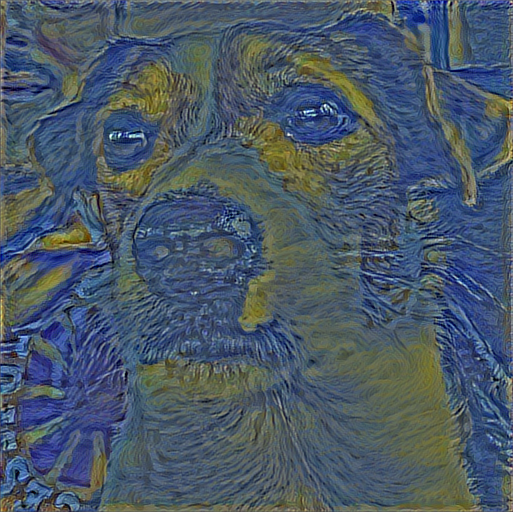

Tempo totale trascorso: 3026.0984807014465 secondi

Iterazione 461 completata in 6.526782512664795 secondi
Perdita Stile: 5.241041477678345e-26 Perdita Contenuto: 8.727494421600923e-11
Tempo totale trascorso: 3032.6813888549805 secondi

Iterazione 462 completata in 6.48164439201355 secondi
Perdita Stile: 7.288578644688475e-26 Perdita Contenuto: 8.530459671973745e-11
Tempo totale trascorso: 3039.1632056236267 secondi

Iterazione 463 completata in 6.515798330307007 secondi
Perdita Stile: 5.251684320625424e-26 Perdita Contenuto: 8.725927619357421e-11
Tempo totale trascorso: 3045.6791729927063 secondi

Iterazione 464 completata in 6.483706951141357 secondi
Perdita Stile: 7.302479852952666e-26 Perdita Contenuto: 8.528946993102693e-11
Tempo totale trascorso: 3052.1630489826202 secondi

Iterazione 465 completata in 6.819037675857544 secondi
Perdita Stile: 5.26226738270703e-26 Perdita Contenuto: 8.724428124384787e-11
Tempo totale trascorso: 3058.982264280319 secondi

Iterazione 466 completata 

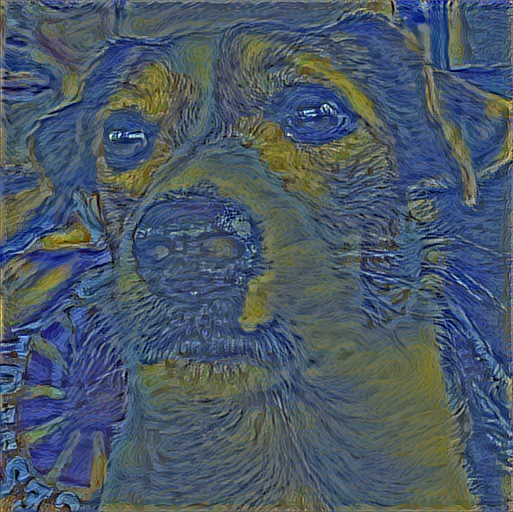

Tempo totale trascorso: 3091.6952533721924 secondi

Iterazione 471 completata in 6.491551399230957 secondi
Perdita Stile: 5.293184567215871e-26 Perdita Contenuto: 8.719849148297598e-11
Tempo totale trascorso: 3098.2440345287323 secondi

Iterazione 472 completata in 6.536460638046265 secondi
Perdita Stile: 7.357799956526454e-26 Perdita Contenuto: 8.523058647735837e-11
Tempo totale trascorso: 3104.780659675598 secondi

Iterazione 473 completata in 6.474843502044678 secondi
Perdita Stile: 5.303582740022816e-26 Perdita Contenuto: 8.718308713850931e-11
Tempo totale trascorso: 3111.2556524276733 secondi

Iterazione 474 completata in 6.523484468460083 secondi
Perdita Stile: 7.370965921775077e-26 Perdita Contenuto: 8.521549438311737e-11
Tempo totale trascorso: 3117.779547929764 secondi

Iterazione 475 completata in 6.541229486465454 secondi
Perdita Stile: 5.313936539403842e-26 Perdita Contenuto: 8.716758564952798e-11
Tempo totale trascorso: 3124.321193933487 secondi

Iterazione 476 completata 

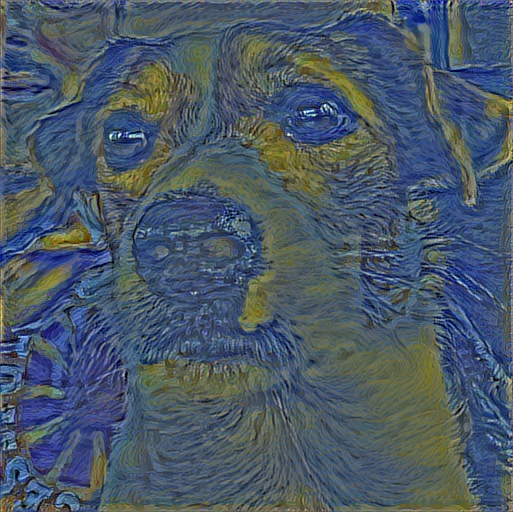

Tempo totale trascorso: 3156.8481924533844 secondi

Iterazione 481 completata in 6.499979496002197 secondi
Perdita Stile: 5.344400128892181e-26 Perdita Contenuto: 8.712362775664673e-11
Tempo totale trascorso: 3163.404214859009 secondi

Iterazione 482 completata in 6.480331182479858 secondi
Perdita Stile: 7.423753042286006e-26 Perdita Contenuto: 8.51585399419541e-11
Tempo totale trascorso: 3169.8847239017487 secondi

Iterazione 483 completata in 6.5082714557647705 secondi
Perdita Stile: 5.354562259725142e-26 Perdita Contenuto: 8.710933363520468e-11
Tempo totale trascorso: 3176.3931732177734 secondi

Iterazione 484 completata in 7.214193105697632 secondi
Perdita Stile: 7.43619239268521e-26 Perdita Contenuto: 8.514419724825473e-11
Tempo totale trascorso: 3183.6075427532196 secondi

Iterazione 485 completata in 6.525608539581299 secondi
Perdita Stile: 5.364808207029282e-26 Perdita Contenuto: 8.709539339735173e-11
Tempo totale trascorso: 3190.133323431015 secondi

Iterazione 486 completata 

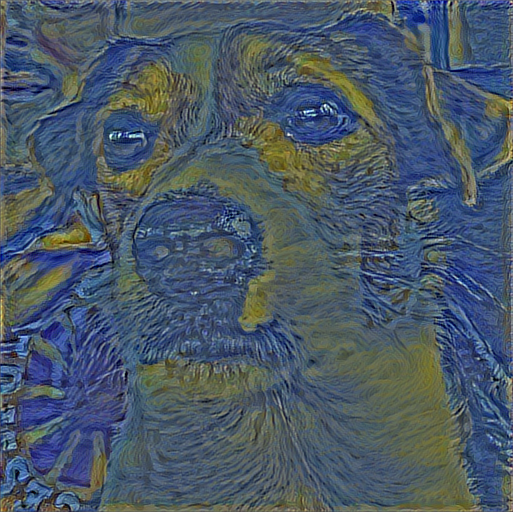

Tempo totale trascorso: 3223.1068348884583 secondi

Iterazione 491 completata in 6.527881622314453 secondi
Perdita Stile: 5.394867505303695e-26 Perdita Contenuto: 8.705132448216801e-11
Tempo totale trascorso: 3229.691830635071 secondi

Iterazione 492 completata in 6.456513404846191 secondi
Perdita Stile: 7.485802499159879e-26 Perdita Contenuto: 8.508840160237341e-11
Tempo totale trascorso: 3236.148495197296 secondi

Iterazione 493 completata in 6.517593622207642 secondi
Perdita Stile: 5.404847828349906e-26 Perdita Contenuto: 8.703733567205774e-11
Tempo totale trascorso: 3242.6662786006927 secondi

Iterazione 494 completata in 6.510654926300049 secondi
Perdita Stile: 7.497782091562758e-26 Perdita Contenuto: 8.507501647603277e-11
Tempo totale trascorso: 3249.1771144866943 secondi

Iterazione 495 completata in 6.458124160766602 secondi
Perdita Stile: 5.415129520913813e-26 Perdita Contenuto: 8.702346482314383e-11
Tempo totale trascorso: 3255.6353919506073 secondi

Iterazione 496 completata

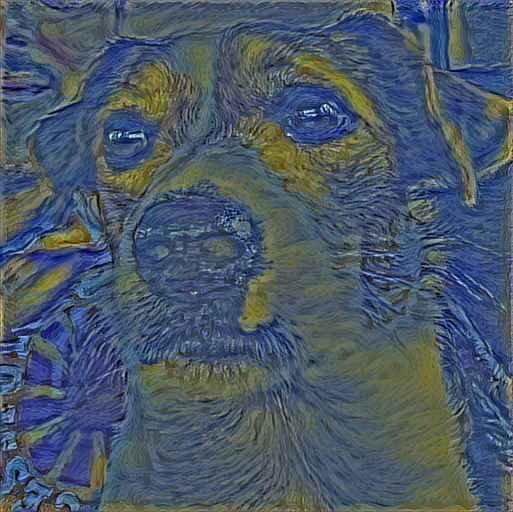

Tempo totale trascorso: 3288.1047236919403 secondi

Iterazione 501 completata in 6.53898811340332 secondi
Perdita Stile: 5.444569440118112e-26 Perdita Contenuto: 8.698129022599588e-11
Tempo totale trascorso: 3294.7030687332153 secondi

Iterazione 502 completata in 7.131431341171265 secondi
Perdita Stile: 7.545321438161222e-26 Perdita Contenuto: 8.502027554202485e-11
Tempo totale trascorso: 3301.8346512317657 secondi

Iterazione 503 completata in 6.560333728790283 secondi
Perdita Stile: 5.454168274960938e-26 Perdita Contenuto: 8.696760672721737e-11
Tempo totale trascorso: 3308.395340681076 secondi

Iterazione 504 completata in 6.496016025543213 secondi
Perdita Stile: 7.55684188886536e-26 Perdita Contenuto: 8.500648102094388e-11
Tempo totale trascorso: 3314.891755104065 secondi

Iterazione 505 completata in 6.470900535583496 secondi
Perdita Stile: 5.464008698455988e-26 Perdita Contenuto: 8.695343056697169e-11
Tempo totale trascorso: 3321.3628313541412 secondi

Iterazione 506 completata i

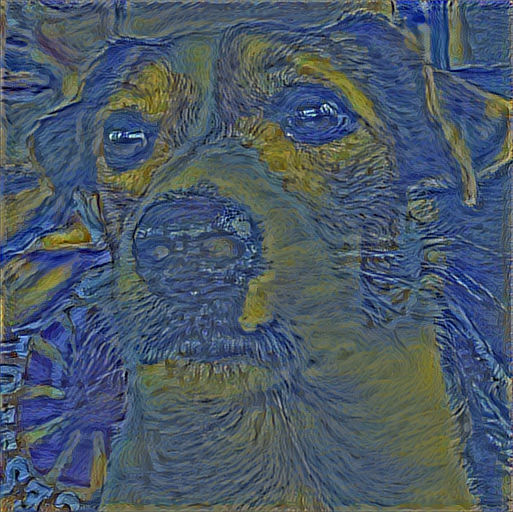

Tempo totale trascorso: 3353.824590921402 secondi

Iterazione 511 completata in 6.488124847412109 secondi
Perdita Stile: 5.492778085890849e-26 Perdita Contenuto: 8.691211639266783e-11
Tempo totale trascorso: 3360.368975877762 secondi

Iterazione 512 completata in 6.4174275398254395 secondi
Perdita Stile: 7.602025129807058e-26 Perdita Contenuto: 8.495319725465578e-11
Tempo totale trascorso: 3366.7865958213806 secondi

Iterazione 513 completata in 6.501189708709717 secondi
Perdita Stile: 5.502362129591702e-26 Perdita Contenuto: 8.68992933167334e-11
Tempo totale trascorso: 3373.2879757881165 secondi

Iterazione 514 completata in 6.494547605514526 secondi
Perdita Stile: 7.613200453865161e-26 Perdita Contenuto: 8.494012437854082e-11
Tempo totale trascorso: 3379.7827095985413 secondi

Iterazione 515 completata in 6.501145601272583 secondi
Perdita Stile: 5.511954801458706e-26 Perdita Contenuto: 8.688572777915127e-11
Tempo totale trascorso: 3386.2840082645416 secondi

Iterazione 516 completata

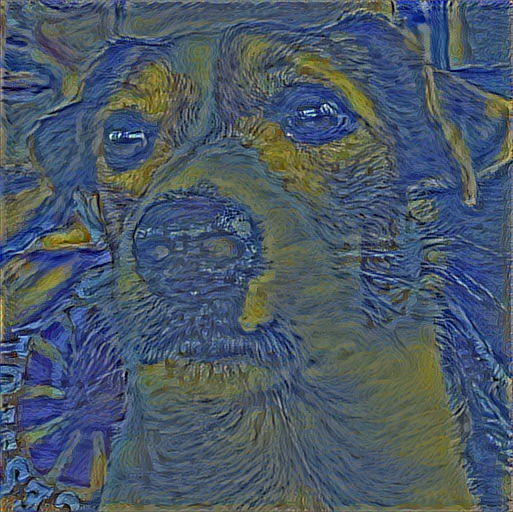

Tempo totale trascorso: 3419.154032468796 secondi

Iterazione 521 completata in 6.701467514038086 secondi
Perdita Stile: 5.540494926192987e-26 Perdita Contenuto: 8.684557240012936e-11
Tempo totale trascorso: 3425.918031692505 secondi

Iterazione 522 completata in 6.582351446151733 secondi
Perdita Stile: 7.656077509254252e-26 Perdita Contenuto: 8.488851288568355e-11
Tempo totale trascorso: 3432.5005538463593 secondi

Iterazione 523 completata in 6.522419691085815 secondi
Perdita Stile: 5.549870045013473e-26 Perdita Contenuto: 8.683245095175707e-11
Tempo totale trascorso: 3439.023124933243 secondi

Iterazione 524 completata in 6.496546030044556 secondi
Perdita Stile: 7.667002000196399e-26 Perdita Contenuto: 8.48756204208101e-11
Tempo totale trascorso: 3445.519821166992 secondi

Iterazione 525 completata in 6.534276962280273 secondi
Perdita Stile: 5.55911389244895e-26 Perdita Contenuto: 8.681981522595805e-11
Tempo totale trascorso: 3452.054455280304 secondi

Iterazione 526 completata in 6

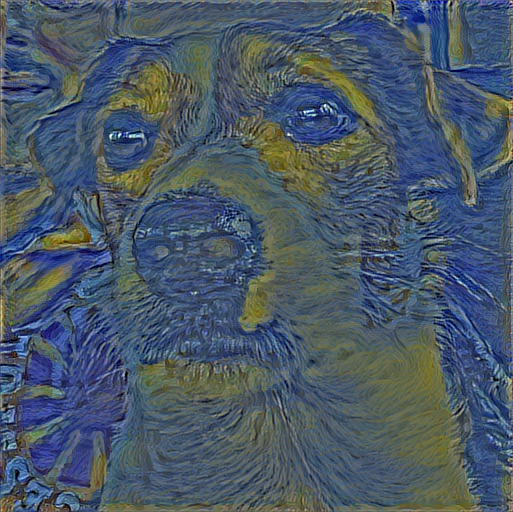

Tempo totale trascorso: 3484.6900346279144 secondi

Iterazione 531 completata in 6.537439346313477 secondi
Perdita Stile: 5.587225690363599e-26 Perdita Contenuto: 8.678127660921575e-11
Tempo totale trascorso: 3491.286443710327 secondi

Iterazione 532 completata in 6.493138313293457 secondi
Perdita Stile: 7.708091792597098e-26 Perdita Contenuto: 8.482704816348274e-11
Tempo totale trascorso: 3497.779727458954 secondi

Iterazione 533 completata in 6.475309610366821 secondi
Perdita Stile: 5.596499736380604e-26 Perdita Contenuto: 8.676899476700584e-11
Tempo totale trascorso: 3504.2551753520966 secondi

Iterazione 534 completata in 6.5273871421813965 secondi
Perdita Stile: 7.718017265158492e-26 Perdita Contenuto: 8.481497448808994e-11
Tempo totale trascorso: 3510.782963514328 secondi

Iterazione 535 completata in 6.498082637786865 secondi
Perdita Stile: 5.605698594092579e-26 Perdita Contenuto: 8.675630353005559e-11
Tempo totale trascorso: 3517.2811946868896 secondi

Iterazione 536 completata

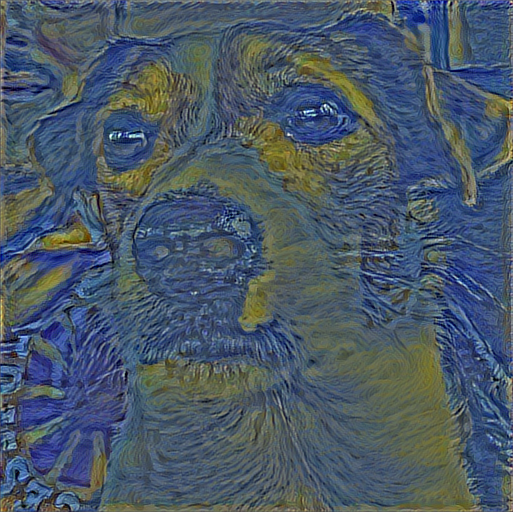

Tempo totale trascorso: 3550.5827107429504 secondi

Iterazione 541 completata in 6.532573461532593 secondi
Perdita Stile: 5.633250793802588e-26 Perdita Contenuto: 8.672015189281623e-11
Tempo totale trascorso: 3557.172319173813 secondi

Iterazione 542 completata in 6.490773677825928 secondi
Perdita Stile: 7.756845245432503e-26 Perdita Contenuto: 8.476742224816647e-11
Tempo totale trascorso: 3563.6632313728333 secondi

Iterazione 543 completata in 6.522046089172363 secondi
Perdita Stile: 5.642254901478587e-26 Perdita Contenuto: 8.670700268886833e-11
Tempo totale trascorso: 3570.1854679584503 secondi

Iterazione 544 completata in 6.499257802963257 secondi
Perdita Stile: 7.766264737678908e-26 Perdita Contenuto: 8.475555673959079e-11
Tempo totale trascorso: 3576.684866666794 secondi

Iterazione 545 completata in 6.546288013458252 secondi
Perdita Stile: 5.651387815349267e-26 Perdita Contenuto: 8.669562984175982e-11
Tempo totale trascorso: 3583.2313318252563 secondi

Iterazione 546 completata

In [16]:
%%time
opera = style_transfer(immagine_contenuto, immagine_stile,
                   id_strato_contenuto, id_strati_stile,
                   peso_contenuto=1.5, peso_stile=10.0,
                   minuti=60, passo=0.5)

In [17]:
pygame.init()
pygame.mixer.music.load('squillo.mp3')
pygame.mixer.music.play(-1)

In [21]:
pygame.mixer.music.stop()

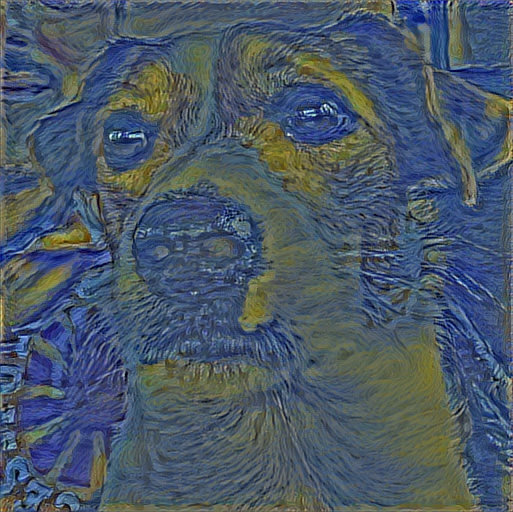

In [19]:
nome_immagine = "opera"
mostra_immagine(opera)

In [20]:
if not os.path.exists("opere"):
    os.makedirs("opere")

nome_opera = "opera"
salva_immagine(opera, "opere/"+nome_opera)